In [1]:
import sys
sys.path.append('/mnt/d/ariel2/code/core/')
sys.path.append('d:/ariel2/code/core/')
sys.path.append('/kaggle/input/my-ariel2-library')
import kaggle_support as kgs
import ariel_model
import ariel_simple
import ariel_gp
import ariel_load
import ariel_load_FGS
import os
import numpy as np
import matplotlib.pyplot as plt
import copy
import importlib
from tqdm import tqdm
import seaborn as sns
import pandas as pd
kgs.debugging_mode = 1
kgs.profiling=False
kgs.n_workers = 4

import warnings
warnings.filterwarnings(
    "ignore",
    message=r".*use_inf_as_na option is deprecated.*",
    category=FutureWarning,
)

local


In [2]:
# Parameters in GP
# 0: 0 t0
# 1: 1 t0
# 2: alpha
# 3: beta
# 4: i
# 5: 0 u0 
# 6: 1 u0
# 7: 0 u1
# 8: 1 u1
# 9: 1 us0
# 10:1 us1

# Parameters in simple
# 0: 0 t0
# 1: alpha
# 2: beta
# 3: i
# 4: 0 rp
# 5: 0 u0
# 6: 0 u1
# 7: 1 rp
# 8: 1 u0
# 9: 1 u1
# 9-xx: poly
# -1: 1 t0

In [3]:
def remove_outlier(mat, threshold):
    while True:
        mu = np.mean(mat,0)
        std = np.std(mat,0)
        scaled = np.abs(mat-mu)/std
        #plt.figure()
        #plt.plot(scaled)
        if np.max(scaled)>threshold:
            max_per_row = np.max(scaled,1)
            to_remove = np.argmax(max_per_row)
            mat = np.delete(mat,to_remove,0)
        else:
            break
    return mat

In [4]:
train_data = kgs.load_all_train_data()
train_data2 = train_data
train_data = train_data[:100]

In [5]:
importlib.reload(ariel_gp)
model = ariel_model.baseline_model()
model = model.model
model.model_options.output_model = True
model.model_options.use_training_labels = True
model.model_options.n_samples_sigma_est = 2
model.train(train_data)

In [6]:
modelr = copy.deepcopy(model)
modelr.model_options.n_iter = 0
modelr.run_in_parallel = False
modelr.infer(train_data[0:1]);

In [7]:
data = copy.deepcopy(train_data)

Processing in parallel:   0%|                                                                   | 0/100 [00:00<?, ?it/s]

local
local
SpawnPoolWorker-3 3
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-1 1
CUDA_VISIBLE_DEVICES= 0
local
local
SpawnPoolWorker-2 2
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-4 4
CUDA_VISIBLE_DEVICES= 0


Processing in parallel:  28%|████████████████▏                                         | 28/100 [01:02<02:26,  2.03s/it]

New solver/alternative transit parameters fallback for planet id 94572221


Processing in parallel:  35%|████████████████████▎                                     | 35/100 [01:16<02:08,  1.98s/it]

New solver/alternative transit parameters fallback for planet id 152245846


Processing in parallel:  36%|████████████████████▉                                     | 36/100 [01:19<02:10,  2.04s/it]

New solver/alternative transit parameters fallback for planet id 155501234


Processing in parallel:  40%|███████████████████████▏                                  | 40/100 [01:29<02:09,  2.17s/it]

New solver/alternative transit parameters fallback for planet id 166602615


Processing in parallel:  70%|████████████████████████████████████████▌                 | 70/100 [02:23<00:56,  1.87s/it]

New solver/alternative transit parameters fallback for planet id 237793157


Processing in parallel:  85%|█████████████████████████████████████████████████▎        | 85/100 [02:49<00:26,  1.80s/it]

New solver/alternative transit parameters fallback for planet id 291916399


Processing in parallel:  96%|███████████████████████████████████████████████████████▋  | 96/100 [03:12<00:07,  1.88s/it]

New solver/alternative transit parameters fallback for planet id 342072318


Processing in parallel: 100%|█████████████████████████████████████████████████████████| 100/100 [03:20<00:00,  2.01s/it]


(100, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


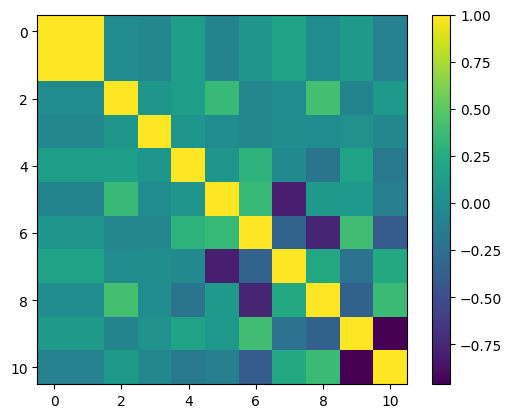

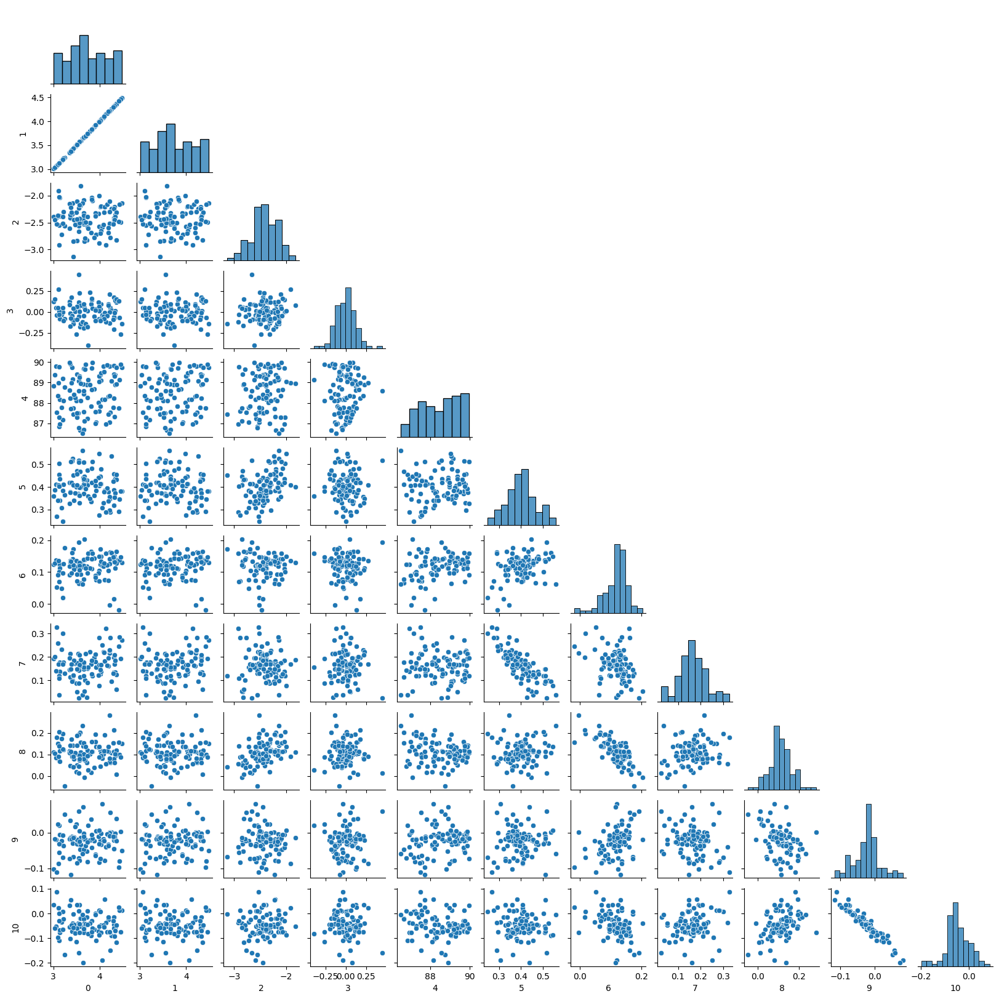

[0.41070746 0.41099692 0.25042372 0.12574439 0.97497741 0.06471388
 0.03808454 0.06191255 0.05344036 0.037833   0.0493974 ]


Processing in parallel:   0%|                                                                   | 0/100 [00:00<?, ?it/s]

local
local
local
local
SpawnPoolWorker-5 5
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-8 8
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-7 7
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-6 6
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|█████████████████████████████████████████████████████████| 100/100 [02:45<00:00,  1.65s/it]


(100, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


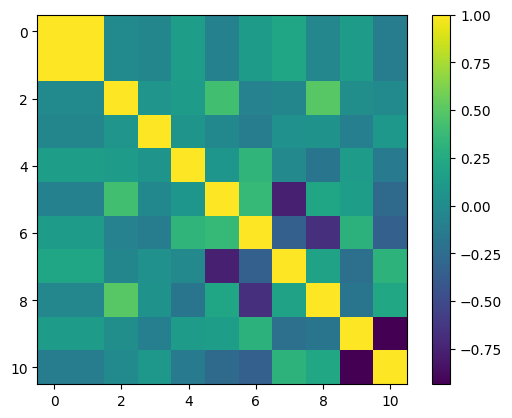

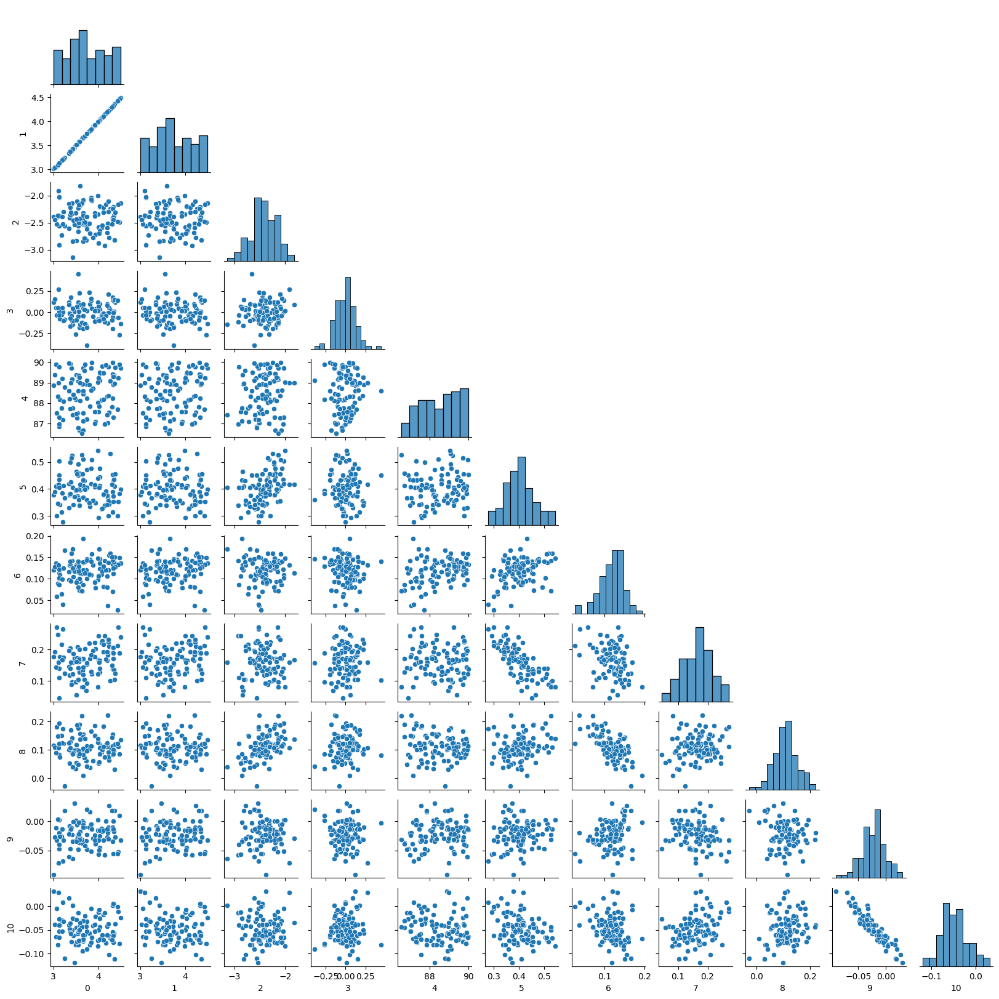

[0.41077155 0.41102084 0.25037897 0.12580915 0.97861162 0.05797711
 0.02940565 0.04860721 0.04401822 0.02230898 0.02940443]


Processing in parallel:   0%|                                                                   | 0/100 [00:00<?, ?it/s]

locallocal

SpawnPoolWorker-9 9
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-11 11
CUDA_VISIBLE_DEVICES= 0
locallocal

SpawnPoolWorker-10 10
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-12 12
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|█████████████████████████████████████████████████████████| 100/100 [02:43<00:00,  1.64s/it]


(100, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


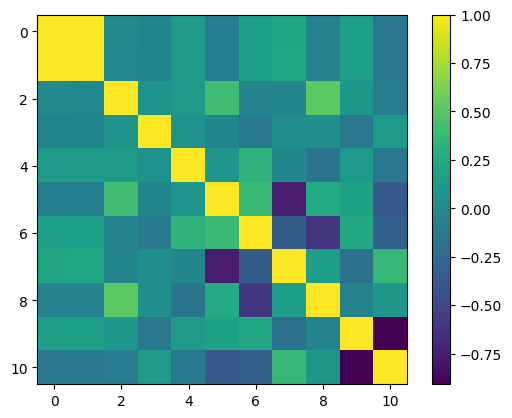

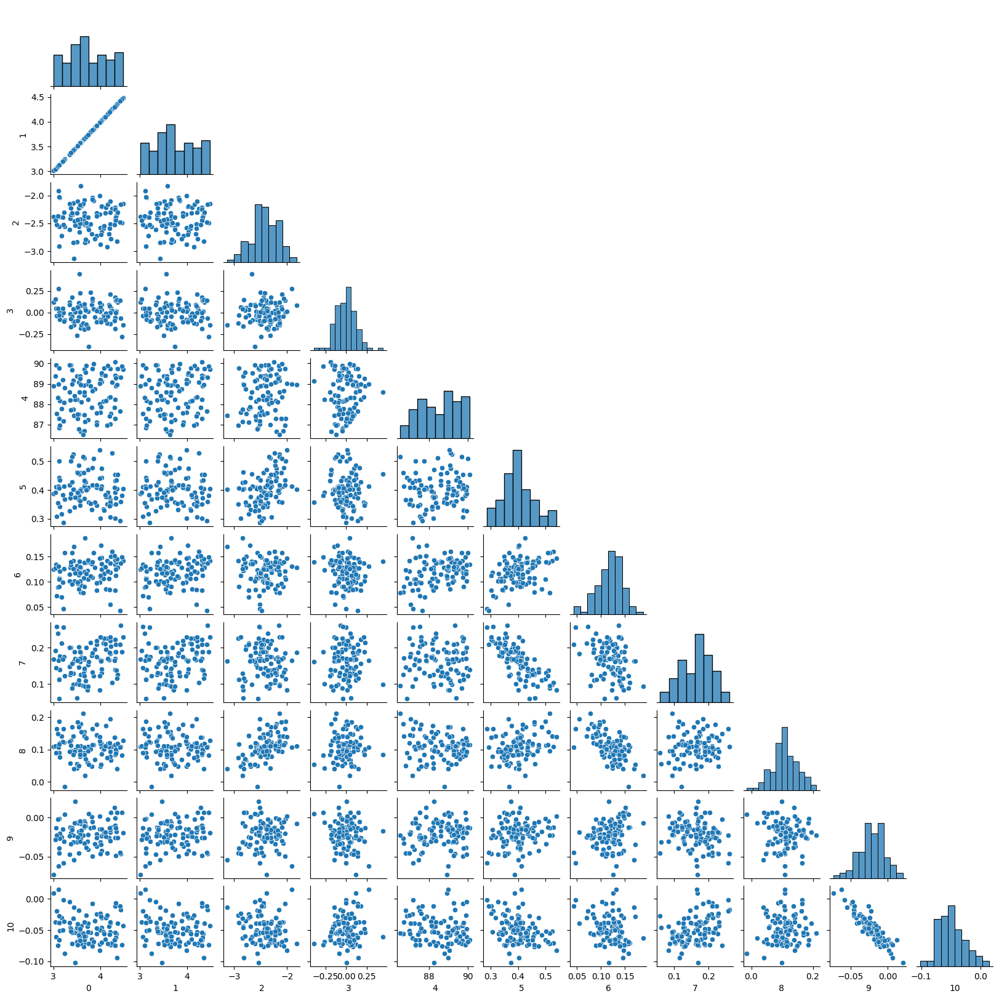

[0.41079429 0.41101393 0.2503259  0.12579401 0.97980707 0.05677531
 0.02630949 0.04477541 0.03994651 0.01677637 0.02225127]


Processing in parallel:   0%|                                                                   | 0/100 [00:00<?, ?it/s]

local
local
local
local
SpawnPoolWorker-16 16
SpawnPoolWorker-13 13
CUDA_VISIBLE_DEVICES= 0
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-14 14
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-15 15
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|█████████████████████████████████████████████████████████| 100/100 [02:43<00:00,  1.63s/it]


(100, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


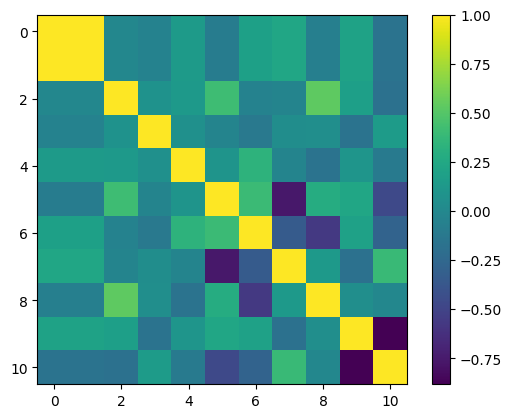

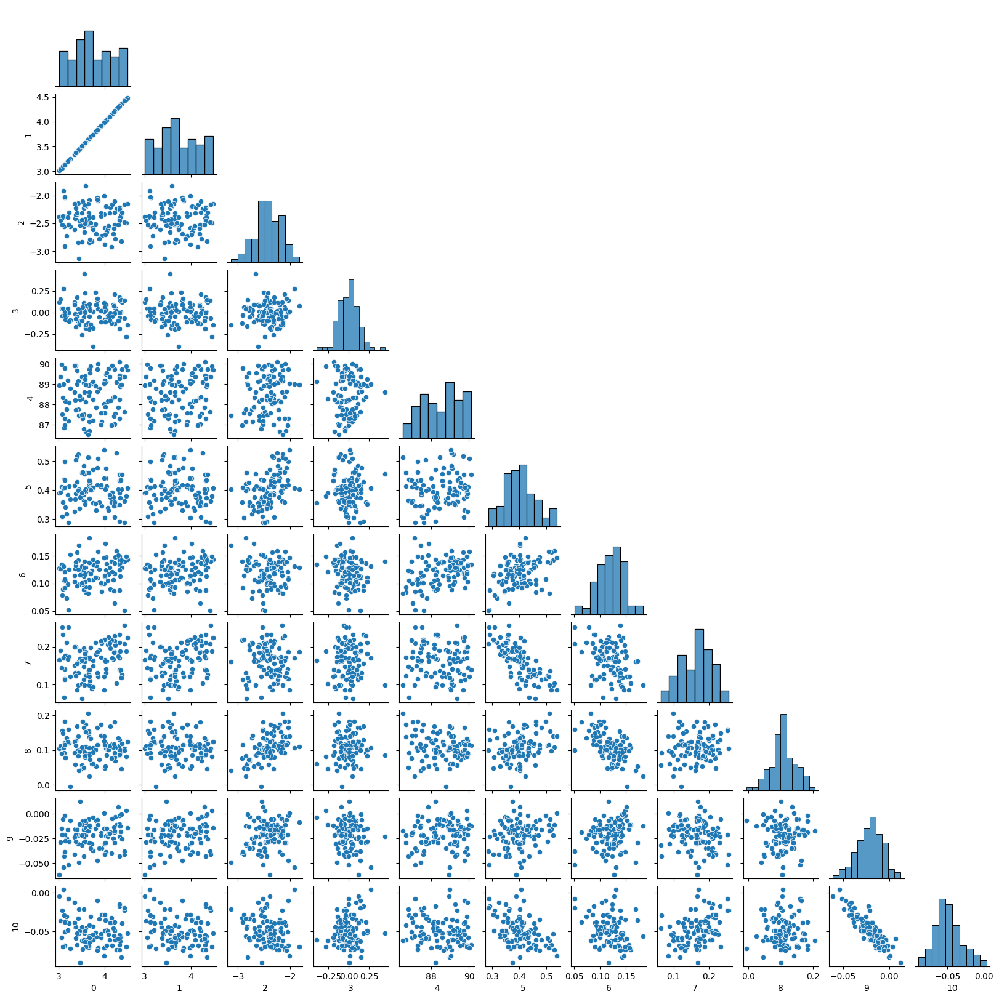

[0.4108057  0.41101059 0.25028795 0.12580323 0.97999836 0.05654453
 0.02475383 0.04330269 0.03769443 0.0138851  0.01862246]


Processing in parallel:   0%|                                                                   | 0/100 [00:00<?, ?it/s]

local
local
local
local
SpawnPoolWorker-17 17
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-18 18
SpawnPoolWorker-20 20
CUDA_VISIBLE_DEVICES= 0
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-19 19
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|█████████████████████████████████████████████████████████| 100/100 [02:43<00:00,  1.63s/it]


(100, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


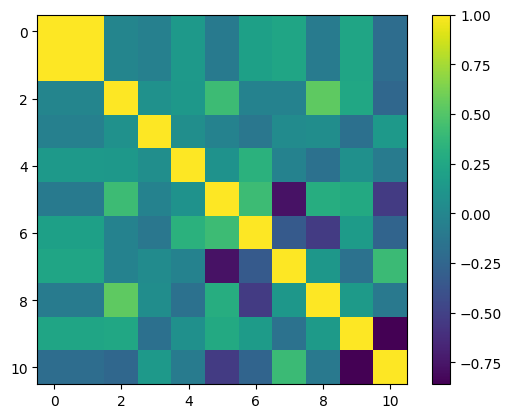

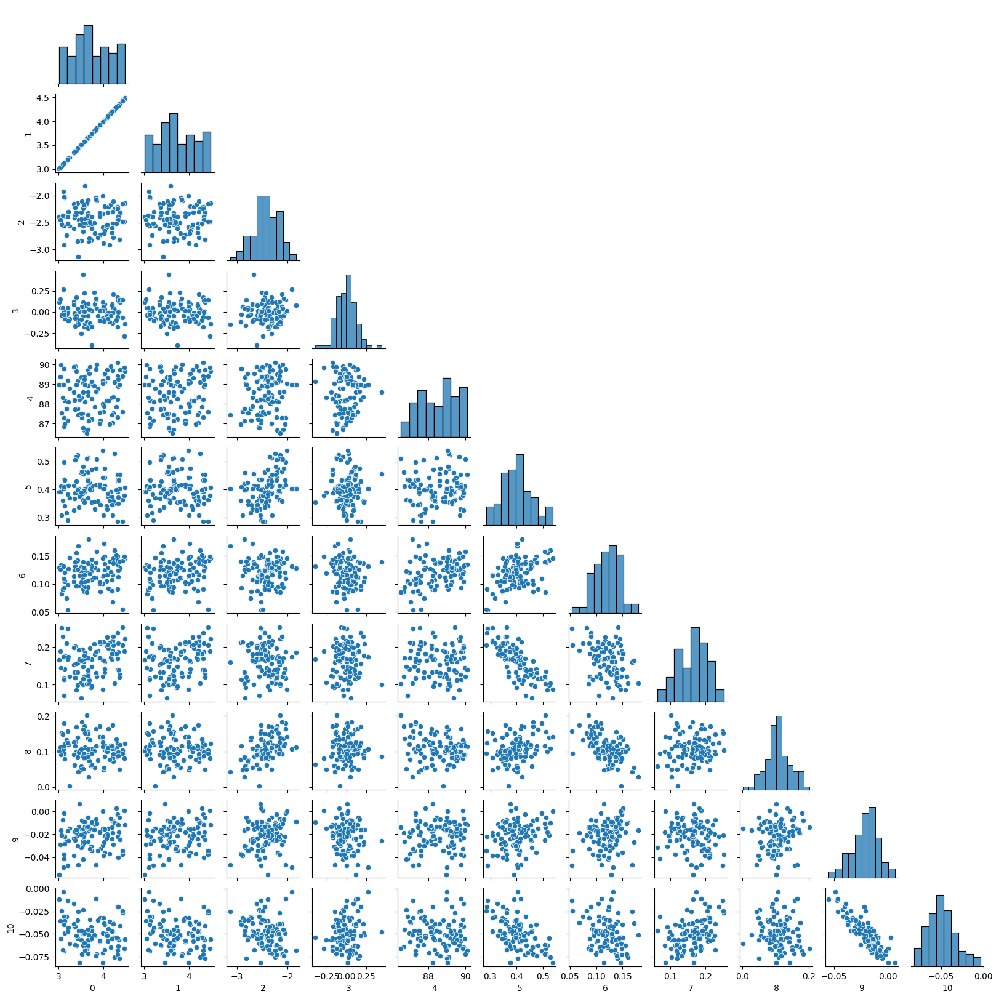

[0.41081106 0.41100889 0.25025732 0.12580529 0.97995463 0.05662742
 0.02385984 0.04275359 0.03625517 0.01216088 0.01659314]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
local
SpawnPoolWorker-24 24
SpawnPoolWorker-23 23
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-22 22
CUDA_VISIBLE_DEVICES= 0
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-21 21
CUDA_VISIBLE_DEVICES= 0


Processing in parallel:   3%|█▍                                                       | 28/1099 [01:00<35:00,  1.96s/it]

New solver/alternative transit parameters fallback for planet id 94572221


Processing in parallel:   3%|█▊                                                       | 35/1099 [01:14<34:23,  1.94s/it]

New solver/alternative transit parameters fallback for planet id 152245846


Processing in parallel:   3%|█▊                                                       | 36/1099 [01:17<35:35,  2.01s/it]

New solver/alternative transit parameters fallback for planet id 155501234


Processing in parallel:   4%|██                                                       | 40/1099 [01:28<37:30,  2.12s/it]

New solver/alternative transit parameters fallback for planet id 166602615


Processing in parallel:   6%|███▋                                                     | 70/1099 [02:21<31:42,  1.85s/it]

New solver/alternative transit parameters fallback for planet id 237793157


Processing in parallel:   8%|████▍                                                    | 85/1099 [02:48<30:39,  1.81s/it]

New solver/alternative transit parameters fallback for planet id 291916399


Processing in parallel:   9%|████▉                                                    | 94/1099 [03:10<32:59,  1.97s/it]

New solver/alternative transit parameters fallback for planet id 342072318


Processing in parallel:  15%|████████▌                                               | 168/1099 [05:23<28:07,  1.81s/it]

New solver/alternative transit parameters fallback for planet id 656960256


Processing in parallel:  16%|████████▉                                               | 175/1099 [05:37<27:56,  1.81s/it]

New solver/alternative transit parameters fallback for planet id 691402002


Processing in parallel:  16%|█████████▏                                              | 180/1099 [05:47<28:30,  1.86s/it]

New solver/alternative transit parameters fallback for planet id 715668790


Processing in parallel:  19%|██████████▊                                             | 212/1099 [06:51<29:09,  1.97s/it]

New solver/alternative transit parameters fallback for planet id 824937040
New solver/alternative transit parameters fallback for planet id 829863746


Processing in parallel:  25%|█████████████▊                                          | 272/1099 [08:40<24:19,  1.76s/it]

New solver/alternative transit parameters fallback for planet id 1053204615


Processing in parallel:  26%|██████████████▋                                         | 288/1099 [09:11<24:30,  1.81s/it]

New solver/alternative transit parameters fallback for planet id 1124834224


Processing in parallel:  28%|███████████████▌                                        | 306/1099 [09:50<25:45,  1.95s/it]

New solver/alternative transit parameters fallback for planet id 1196027041


Processing in parallel:  30%|████████████████▌                                       | 326/1099 [10:29<24:40,  1.91s/it]

New solver/alternative transit parameters fallback for planet id 1267010874


Processing in parallel:  30%|████████████████▋                                       | 327/1099 [10:32<25:29,  1.98s/it]

New solver/alternative transit parameters fallback for planet id 1267583899


Processing in parallel:  30%|████████████████▊                                       | 330/1099 [10:40<26:10,  2.04s/it]

New solver/alternative transit parameters fallback for planet id 1293223638


Processing in parallel:  32%|█████████████████▋                                      | 347/1099 [11:10<23:36,  1.88s/it]

New solver/alternative transit parameters fallback for planet id 1329906799


Processing in parallel:  32%|█████████████████▉                                      | 351/1099 [11:25<27:18,  2.19s/it]

New solver/alternative transit parameters fallback for planet id 1349926825


Processing in parallel:  32%|██████████████████                                      | 355/1099 [11:29<24:54,  2.01s/it]

Attempting chop
New solver/alternative transit parameters fallback for planet id 1349926825


Processing in parallel:  32%|██████████████████▏                                     | 356/1099 [11:31<25:06,  2.03s/it]

New solver/alternative transit parameters fallback for planet id 1349926825


Processing in parallel:  33%|██████████████████▏                                     | 358/1099 [11:43<28:22,  2.30s/it]

New solver/alternative transit parameters fallback for planet id 1370040003


Processing in parallel:  36%|████████████████████                                    | 393/1099 [12:40<21:17,  1.81s/it]

New solver/alternative transit parameters fallback for planet id 1475386345


Processing in parallel:  37%|████████████████████▉                                   | 412/1099 [13:18<21:43,  1.90s/it]

New solver/alternative transit parameters fallback for planet id 1547333761


Processing in parallel:  38%|█████████████████████                                   | 414/1099 [13:21<21:21,  1.87s/it]

Attempting chop
New solver/alternative transit parameters fallback for planet id 1554618542
New solver/alternative transit parameters fallback for planet id 1547333761
Chop used on planet id 1547333761


Processing in parallel:  44%|████████████████████████▊                               | 487/1099 [15:46<19:22,  1.90s/it]

New solver/alternative transit parameters fallback for planet id 1834181716


Processing in parallel:  46%|█████████████████████████▋                              | 504/1099 [16:19<18:55,  1.91s/it]

New solver/alternative transit parameters fallback for planet id 1876150924


Processing in parallel:  50%|███████████████████████████▊                            | 546/1099 [17:36<16:46,  1.82s/it]

New solver/alternative transit parameters fallback for planet id 2069619536


Processing in parallel:  50%|███████████████████████████▉                            | 548/1099 [17:43<17:50,  1.94s/it]

New solver/alternative transit parameters fallback for planet id 2074730139


Processing in parallel:  50%|████████████████████████████▏                           | 552/1099 [17:50<17:30,  1.92s/it]

New solver/alternative transit parameters fallback for planet id 2097642218


Processing in parallel:  51%|████████████████████████████▎                           | 556/1099 [17:57<17:02,  1.88s/it]

New solver/alternative transit parameters fallback for planet id 2101537217


Processing in parallel:  54%|██████████████████████████████▏                         | 592/1099 [19:05<15:30,  1.83s/it]

New solver/alternative transit parameters fallback for planet id 2254664280


Processing in parallel:  54%|██████████████████████████████▏                         | 593/1099 [19:08<15:36,  1.85s/it]

New solver/alternative transit parameters fallback for planet id 2259395627


Processing in parallel:  54%|██████████████████████████████▎                         | 595/1099 [19:12<15:36,  1.86s/it]

New solver/alternative transit parameters fallback for planet id 2264735129


Processing in parallel:  57%|███████████████████████████████▉                        | 626/1099 [20:13<15:02,  1.91s/it]

New solver/alternative transit parameters fallback for planet id 2387200917


Processing in parallel:  59%|████████████████████████████████▉                       | 647/1099 [20:59<15:33,  2.07s/it]

New solver/alternative transit parameters fallback for planet id 2495453637


Processing in parallel:  61%|██████████████████████████████████                      | 668/1099 [21:36<13:55,  1.94s/it]

New solver/alternative transit parameters fallback for planet id 2562716556


Processing in parallel:  65%|████████████████████████████████████▌                   | 718/1099 [23:12<12:18,  1.94s/it]

New solver/alternative transit parameters fallback for planet id 2760210399


Processing in parallel:  70%|███████████████████████████████████████▍                | 774/1099 [25:05<11:08,  2.06s/it]

New solver/alternative transit parameters fallback for planet id 3062170297


Processing in parallel:  71%|███████████████████████████████████████▋                | 778/1099 [25:11<10:38,  1.99s/it]

New solver/alternative transit parameters fallback for planet id 3062684318


Processing in parallel:  71%|████████████████████████████████████████                | 785/1099 [25:22<10:04,  1.92s/it]

New solver/alternative transit parameters fallback for planet id 3098975946


Processing in parallel:  72%|████████████████████████████████████████▎               | 791/1099 [25:34<09:52,  1.92s/it]

New solver/alternative transit parameters fallback for planet id 3126879162


Processing in parallel:  74%|█████████████████████████████████████████▏              | 809/1099 [26:10<09:25,  1.95s/it]

New solver/alternative transit parameters fallback for planet id 3188116178


Processing in parallel:  74%|█████████████████████████████████████████▌              | 815/1099 [26:20<08:51,  1.87s/it]

New solver/alternative transit parameters fallback for planet id 3206727630


Processing in parallel:  77%|███████████████████████████████████████████             | 846/1099 [27:19<07:41,  1.82s/it]

New solver/alternative transit parameters fallback for planet id 3317944304


Processing in parallel:  78%|███████████████████████████████████████████▍            | 852/1099 [27:35<08:15,  2.00s/it]

New solver/alternative transit parameters fallback for planet id 3344833436


Processing in parallel:  80%|█████████████████████████████████████████████           | 884/1099 [28:34<06:39,  1.86s/it]

New solver/alternative transit parameters fallback for planet id 3469305332


Processing in parallel:  81%|█████████████████████████████████████████████▌          | 893/1099 [28:55<06:48,  1.98s/it]

New solver/alternative transit parameters fallback for planet id 3512283046


Processing in parallel:  85%|███████████████████████████████████████████████▍        | 931/1099 [30:07<05:23,  1.92s/it]

New solver/alternative transit parameters fallback for planet id 3653339152


Processing in parallel:  86%|███████████████████████████████████████████████▉        | 941/1099 [30:28<05:16,  2.00s/it]

New solver/alternative transit parameters fallback for planet id 3679528633


Processing in parallel:  88%|█████████████████████████████████████████████████       | 964/1099 [31:10<04:18,  1.91s/it]

New solver/alternative transit parameters fallback for planet id 3786449677


Processing in parallel:  91%|██████████████████████████████████████████████████▋     | 995/1099 [32:09<03:15,  1.88s/it]

New solver/alternative transit parameters fallback for planet id 3884695798


Processing in parallel:  91%|██████████████████████████████████████████████████▊     | 997/1099 [32:11<03:05,  1.82s/it]

Attempting chop
New solver/alternative transit parameters fallback for planet id 3884695798
Chop used on planet id 3884695798
New solver/alternative transit parameters fallback for planet id 3928265625
Attempting chop


Processing in parallel:  91%|██████████████████████████████████████████████████▊     | 998/1099 [32:23<03:48,  2.26s/it]

New solver/alternative transit parameters fallback for planet id 3928265625


Processing in parallel:  91%|██████████████████████████████████████████████████▏    | 1003/1099 [32:25<03:03,  1.91s/it]

Chop used on planet id 3928265625


Processing in parallel:  91%|██████████████████████████████████████████████████▏    | 1004/1099 [32:37<03:37,  2.29s/it]

New solver/alternative transit parameters fallback for planet id 3955853901


Processing in parallel:  92%|██████████████████████████████████████████████████▍    | 1008/1099 [32:39<03:06,  2.05s/it]

New solver/alternative transit parameters fallback for planet id 3965882786


Processing in parallel:  94%|███████████████████████████████████████████████████▍   | 1028/1099 [33:18<02:23,  2.02s/it]

New solver/alternative transit parameters fallback for planet id 4059234082


Processing in parallel:  95%|████████████████████████████████████████████████████▏  | 1043/1099 [33:43<01:45,  1.89s/it]

New solver/alternative transit parameters fallback for planet id 4087358670


Processing in parallel:  97%|█████████████████████████████████████████████████████▎ | 1065/1099 [34:24<01:02,  1.84s/it]

New solver/alternative transit parameters fallback for planet id 4190752810


Processing in parallel:  98%|█████████████████████████████████████████████████████▋ | 1073/1099 [34:44<00:53,  2.06s/it]

New solver/alternative transit parameters fallback for planet id 4220529965


Processing in parallel:  98%|█████████████████████████████████████████████████████▉ | 1077/1099 [34:48<00:41,  1.91s/it]

New solver/alternative transit parameters fallback for planet id 4232767776


Processing in parallel:  99%|██████████████████████████████████████████████████████▋| 1093/1099 [35:21<00:11,  1.99s/it]

New solver/alternative transit parameters fallback for planet id 4293108648


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [35:31<00:00,  1.94s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


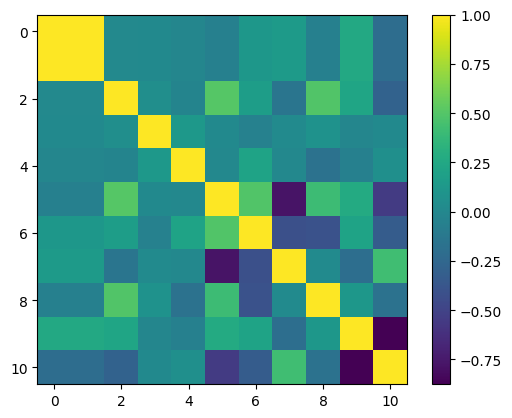

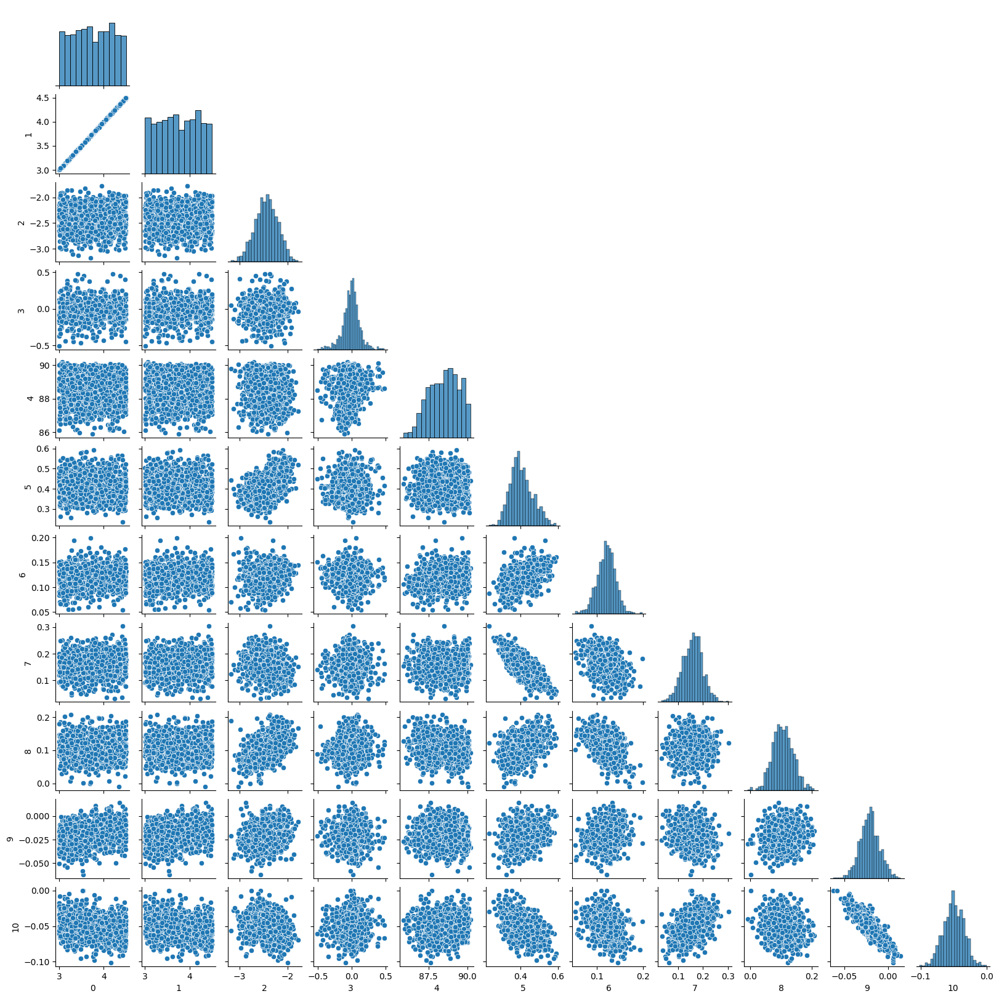

[0.43280572 0.4327554  0.23473581 0.12794022 0.94895113 0.06033608
 0.0201029  0.04015409 0.03336755 0.01119084 0.01571178]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
local
SpawnPoolWorker-25SpawnPoolWorker-26 26
 25
SpawnPoolWorker-27 27
SpawnPoolWorker-28 28
CUDA_VISIBLE_DEVICES=CUDA_VISIBLE_DEVICES=CUDA_VISIBLE_DEVICES=  0 0
0

CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:55<00:00,  1.58s/it]


(1083, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


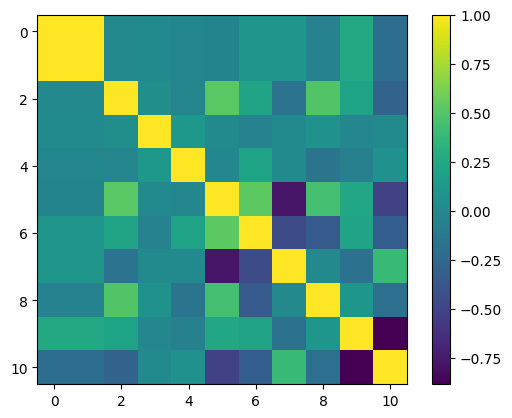

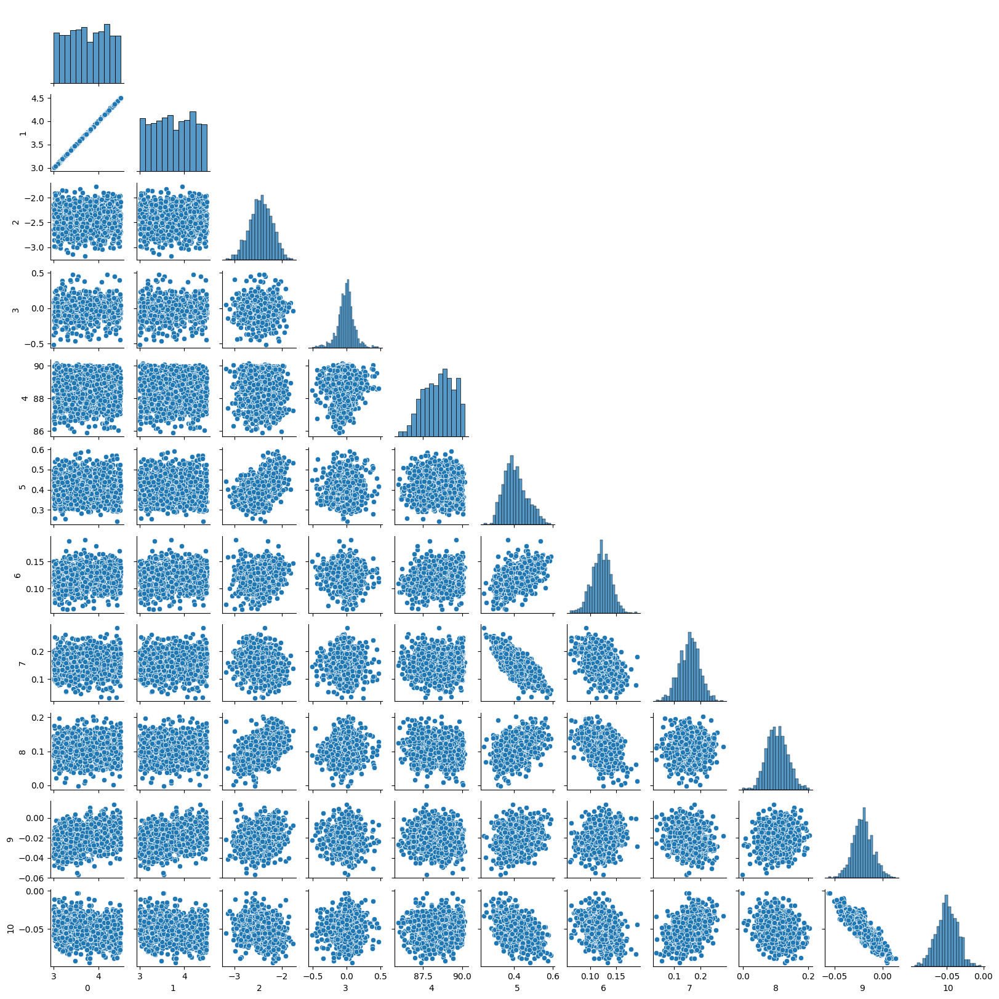

[0.43286194 0.43269923 0.23490255 0.12792161 0.94988818 0.06013597
 0.01869019 0.03845894 0.03221282 0.01043993 0.01456162]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
local
SpawnPoolWorker-31 31
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-29 29
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-32 32
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-30 30
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [29:07<00:00,  1.59s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


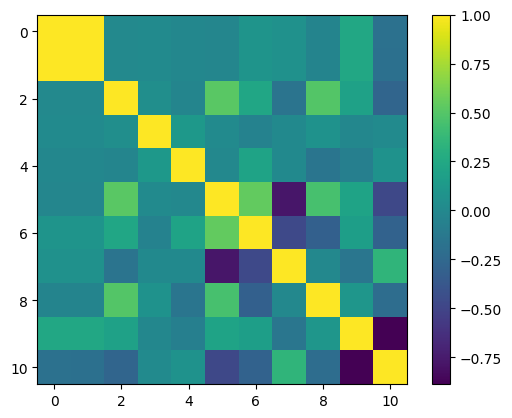

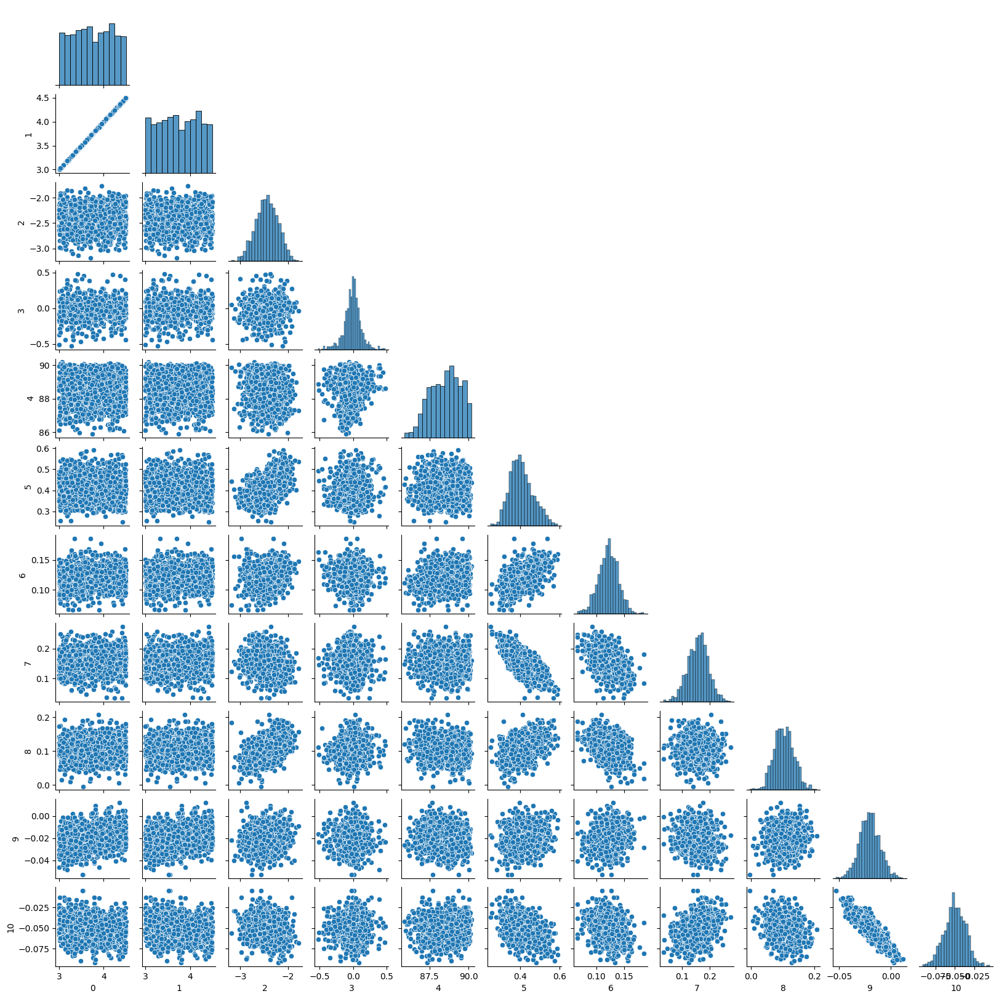

[0.43293013 0.43273255 0.23502765 0.12871802 0.95116902 0.05986598
 0.01786546 0.03747901 0.03172919 0.00990789 0.0136822 ]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

locallocallocal


local
SpawnPoolWorker-35SpawnPoolWorker-36SpawnPoolWorker-34  3634

 35
CUDA_VISIBLE_DEVICES=CUDA_VISIBLE_DEVICES= CUDA_VISIBLE_DEVICES= 0 0
0

SpawnPoolWorker-33 33
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [29:02<00:00,  1.59s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


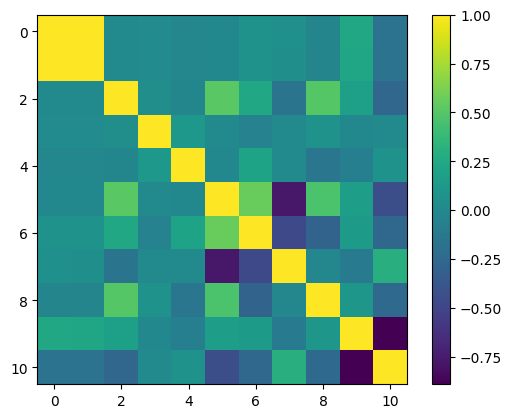

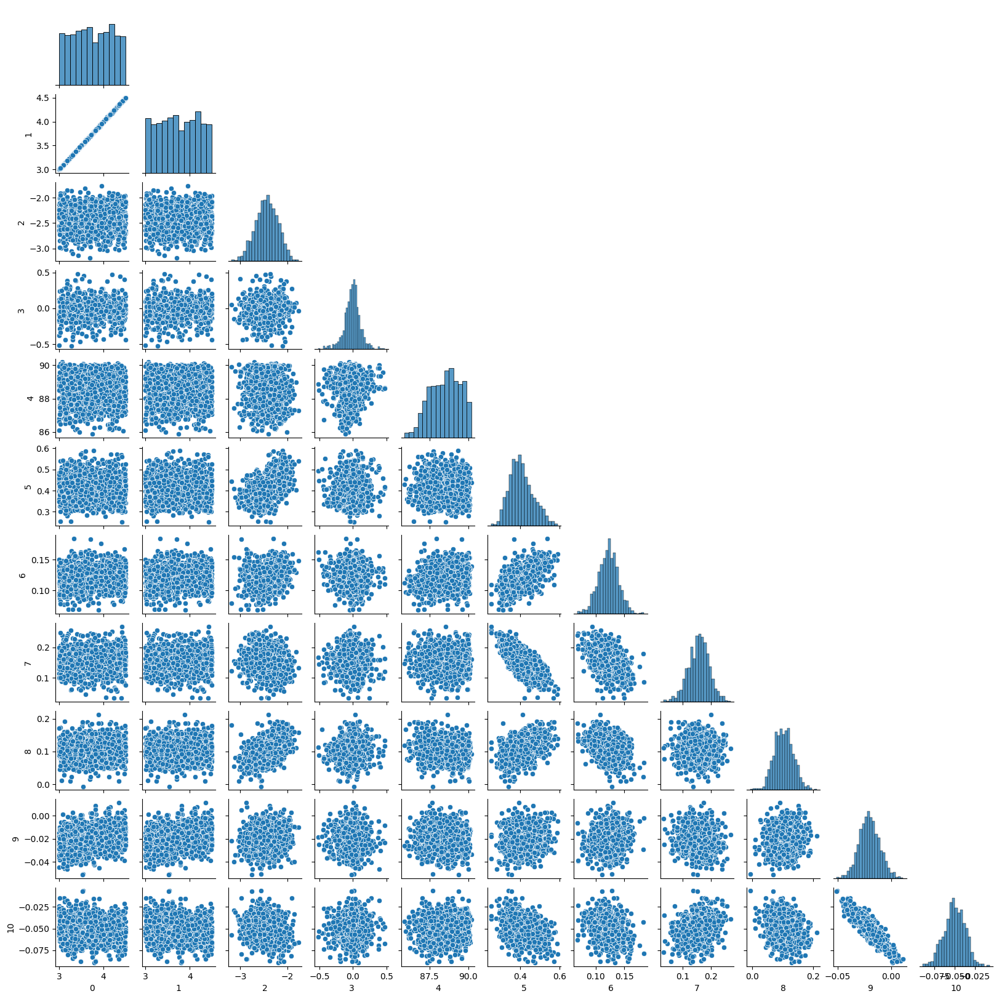

[0.43293879 0.43273193 0.23504437 0.12861232 0.95131138 0.05960234
 0.01728371 0.03689502 0.03149259 0.00954176 0.01307127]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

locallocal

local
local
SpawnPoolWorker-38 38
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-39 39
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-37 37
SpawnPoolWorker-40 40
CUDA_VISIBLE_DEVICES= 0
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:51<00:00,  1.58s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


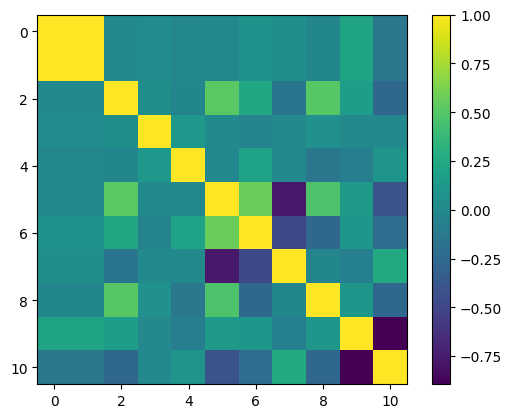

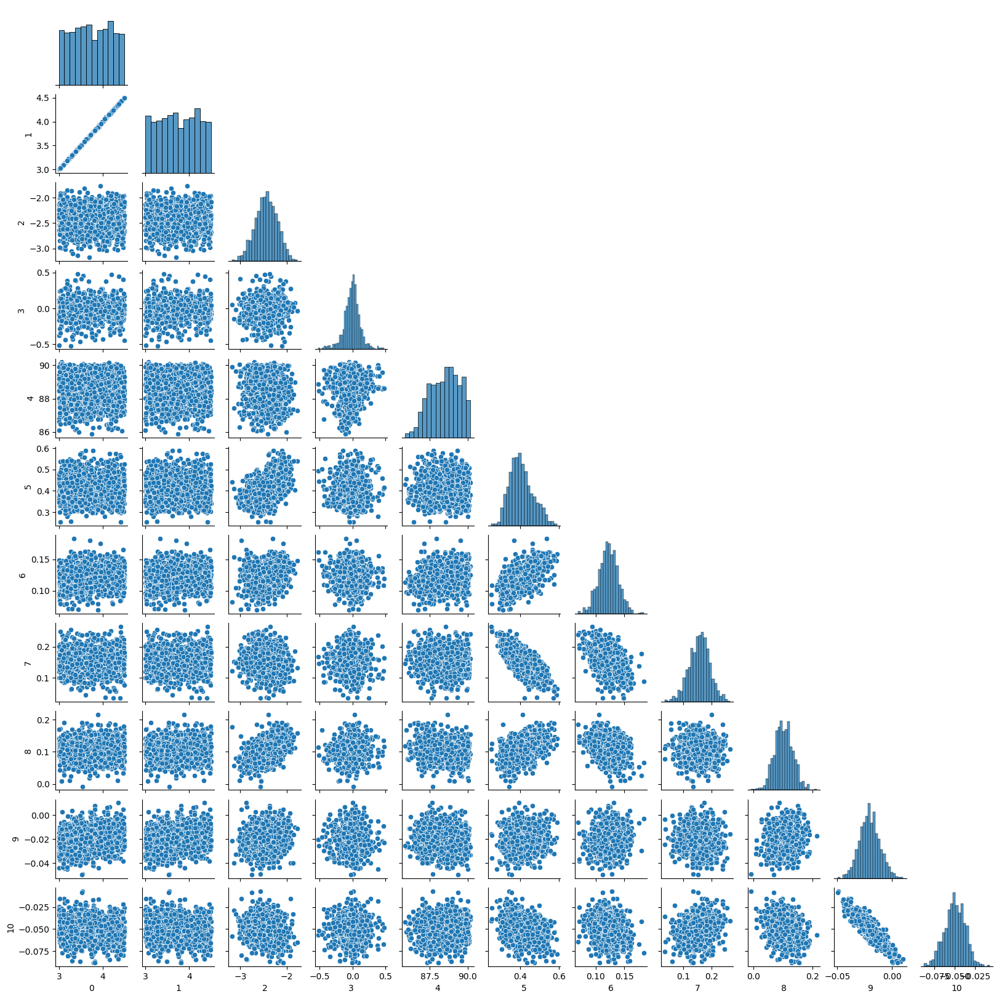

[0.43293923 0.43273165 0.23504767 0.12848508 0.95253251 0.05949297
 0.01684426 0.0365712  0.03132854 0.00928205 0.01266226]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
local
SpawnPoolWorker-43 43
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-44 44
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-41 41
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-42 42
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:56<00:00,  1.58s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


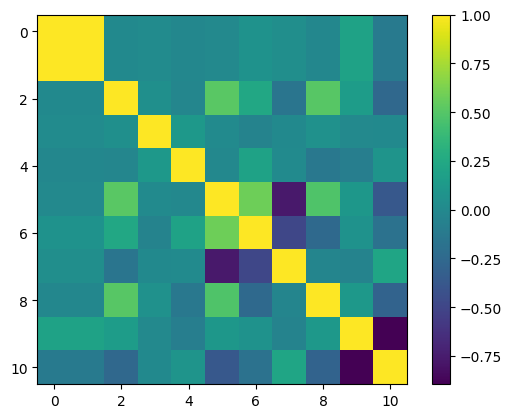

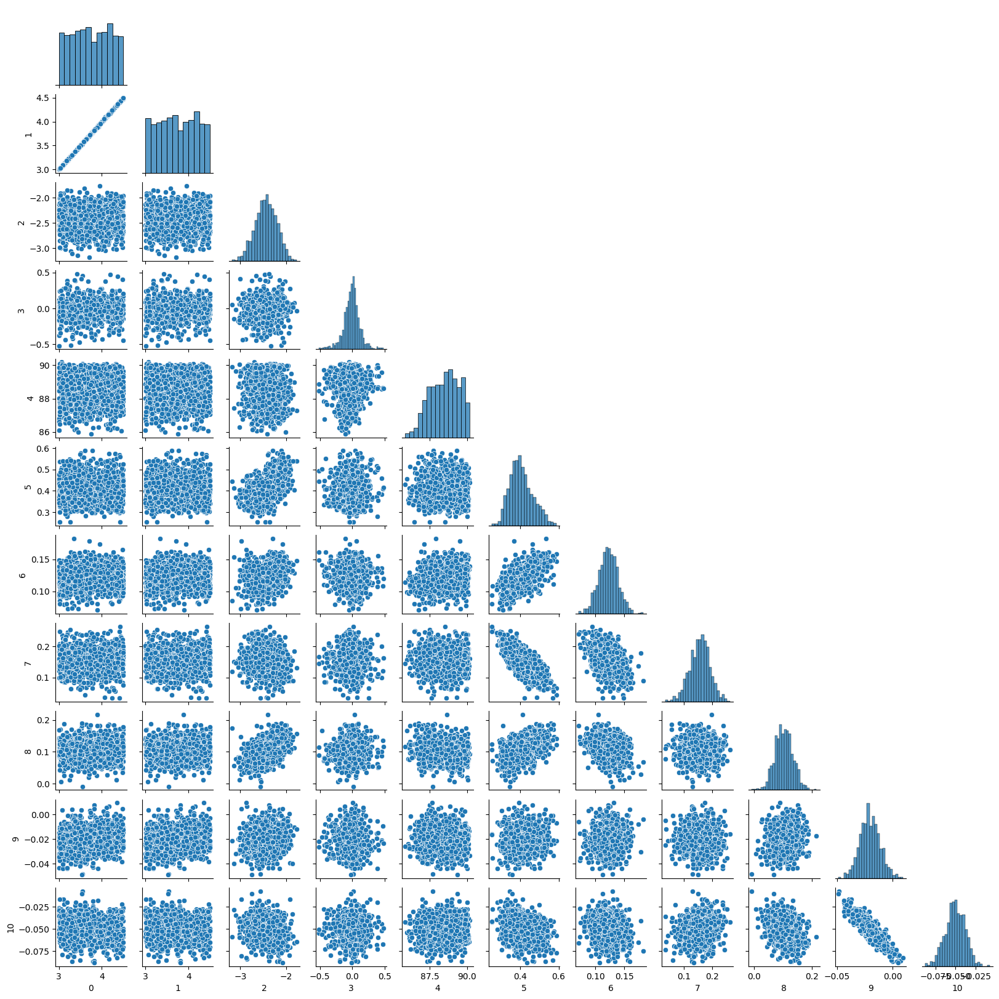

[0.43294056 0.43273173 0.23505403 0.12841882 0.95246692 0.05945329
 0.01646571 0.03640379 0.0311727  0.00907582 0.01235177]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
local
SpawnPoolWorker-48SpawnPoolWorker-47SpawnPoolWorker-46   474648


CUDA_VISIBLE_DEVICES=CUDA_VISIBLE_DEVICES=CUDA_VISIBLE_DEVICES=   00
0

SpawnPoolWorker-45 45
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [29:01<00:00,  1.58s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


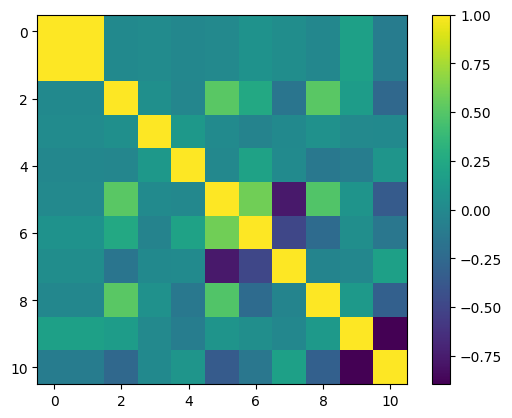

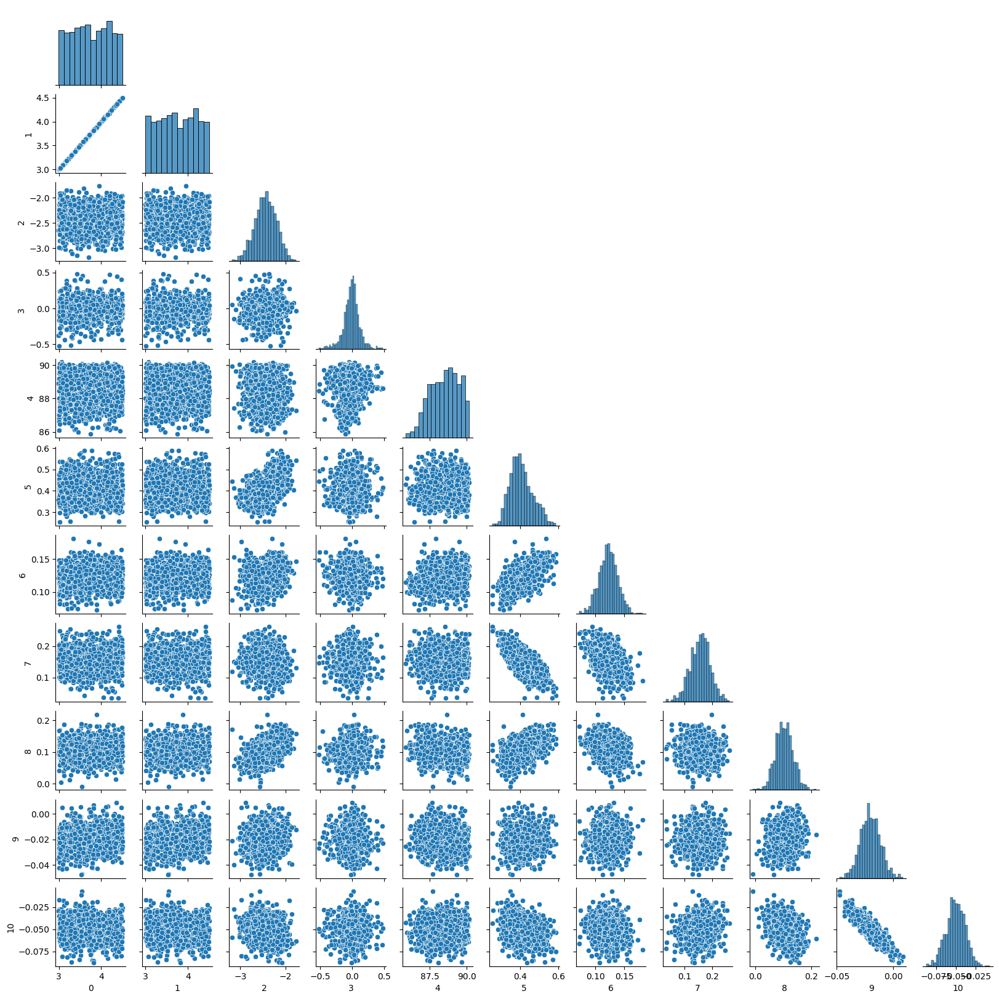

[0.43294222 0.43273188 0.23506119 0.12832622 0.95378245 0.05943163
 0.01616857 0.03628492 0.03102403 0.00893391 0.01215614]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

locallocal

local
SpawnPoolWorker-49 49
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-51 51
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-50 50
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-52 52
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [29:09<00:00,  1.59s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


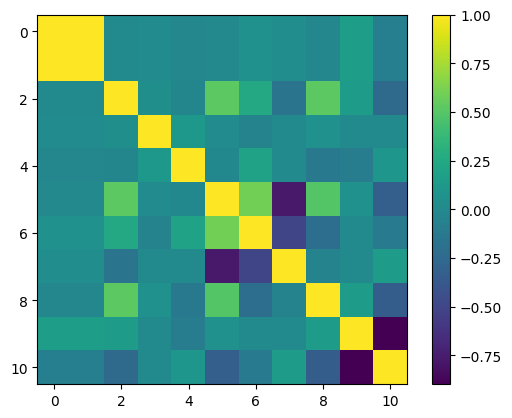

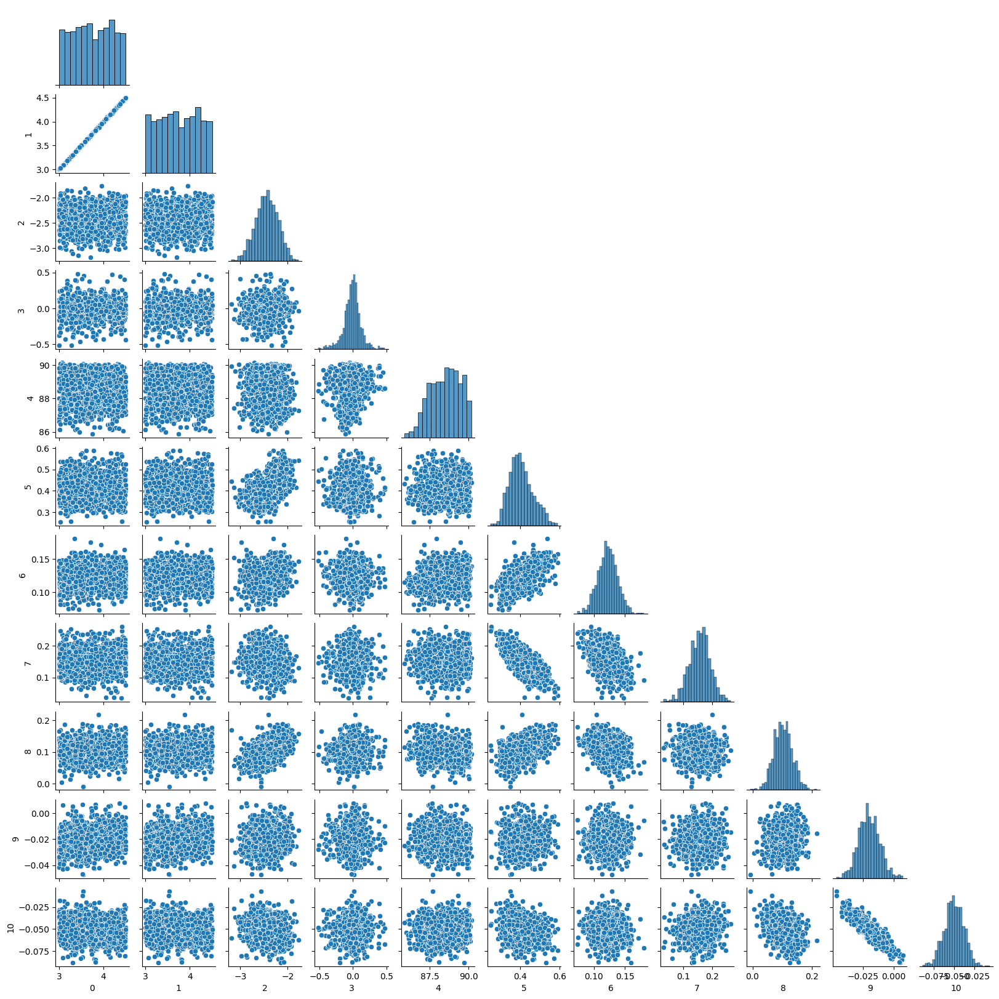

[0.43294232 0.43273401 0.23505584 0.12823166 0.95353484 0.05946174
 0.0159285  0.03621589 0.03083642 0.00881395 0.01200562]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
SpawnPoolWorker-53 53
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-54 54
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-55 55
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-56 56
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [29:14<00:00,  1.60s/it]


(1085, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


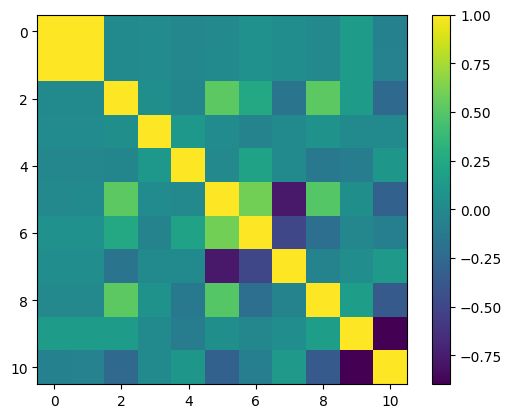

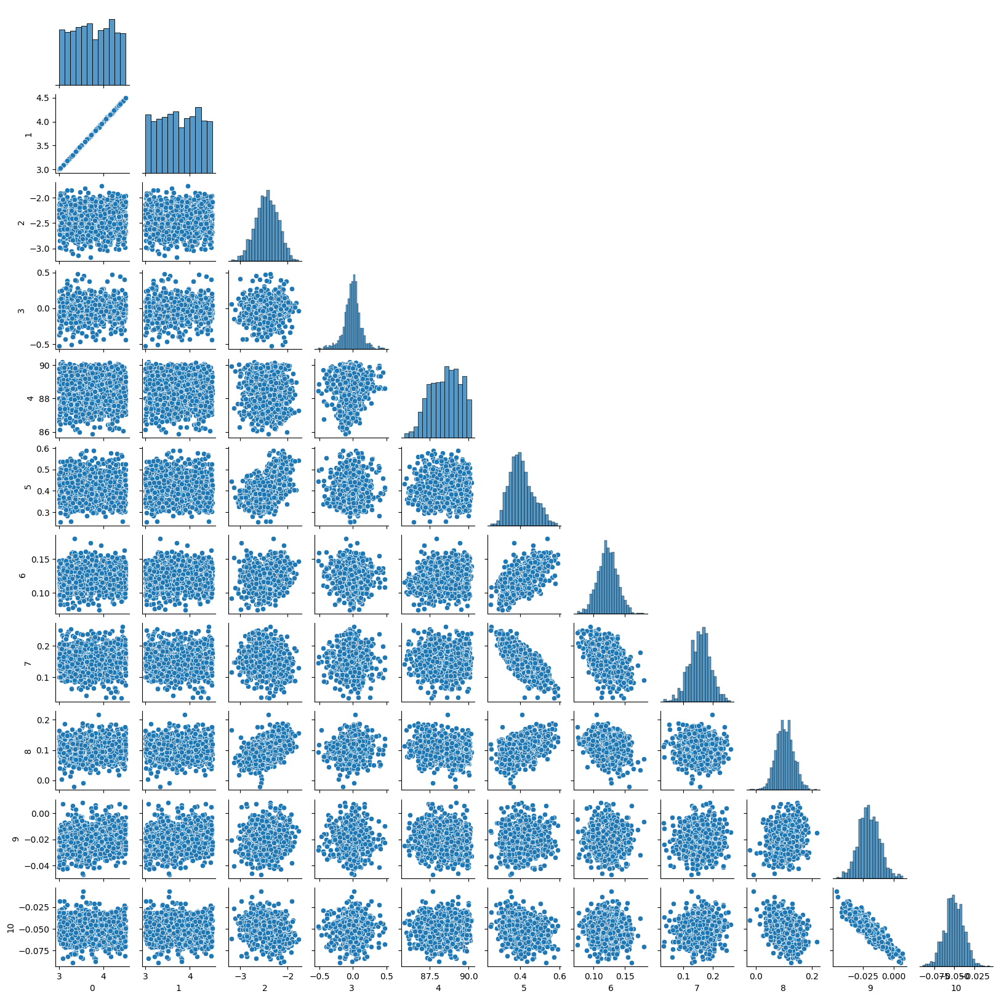

[0.43293507 0.43272525 0.23500858 0.12815142 0.95483175 0.0595403
 0.01572891 0.03620539 0.03088179 0.00872342 0.01192191]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
SpawnPoolWorker-58 58
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-57 57
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-60 60
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-59 59
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [29:04<00:00,  1.59s/it]


(1085, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


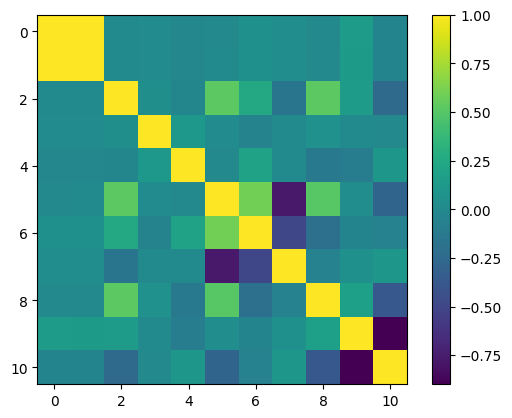

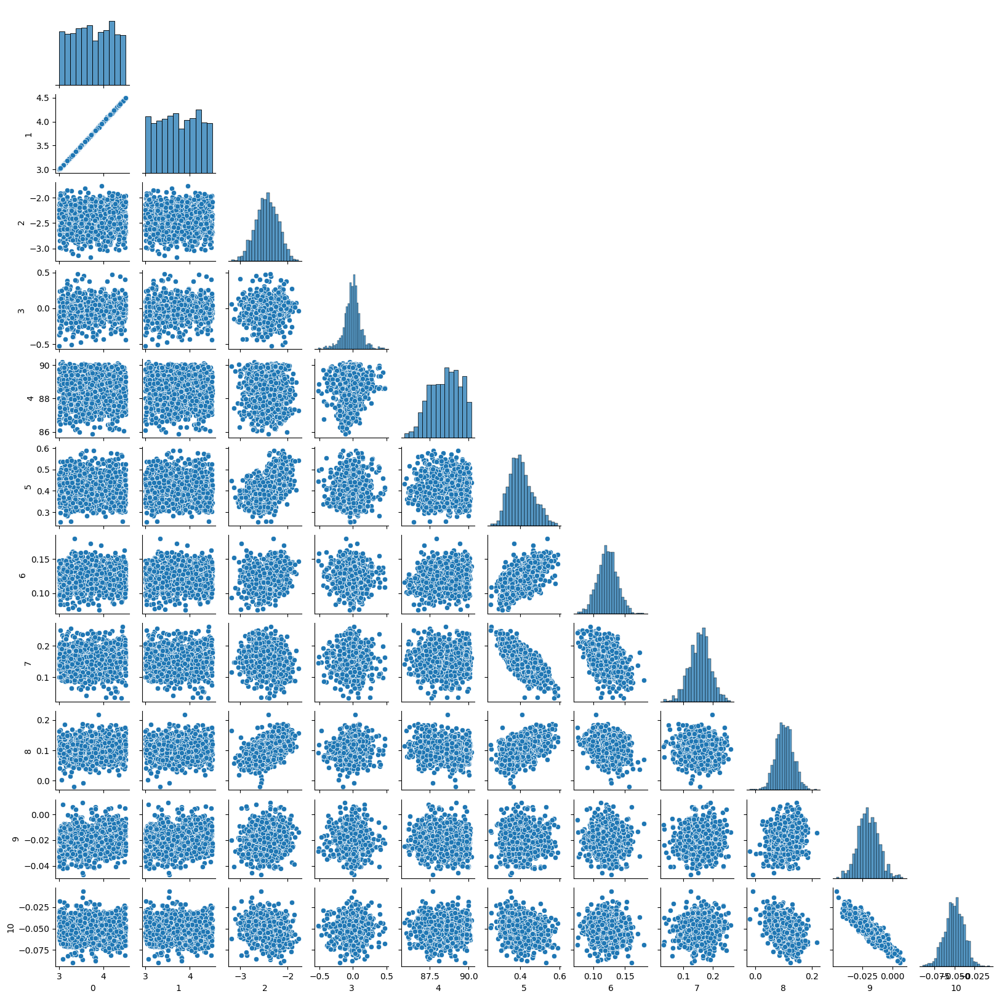

[0.43293434 0.43272354 0.23498497 0.12810022 0.95446663 0.05944484
 0.01552889 0.03611659 0.03086755 0.00866542 0.01186584]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
local
SpawnPoolWorker-63SpawnPoolWorker-62 62
 63
CUDA_VISIBLE_DEVICES= 0
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-61 61
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-64 64
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [29:39<00:00,  1.62s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


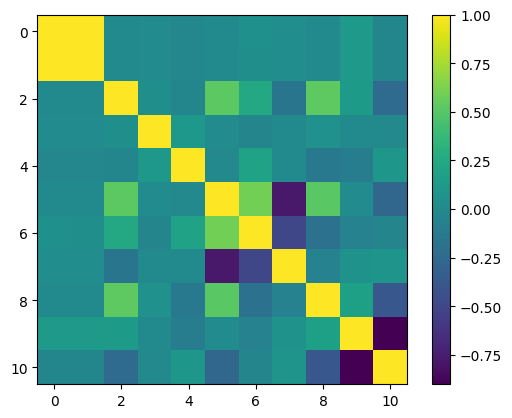

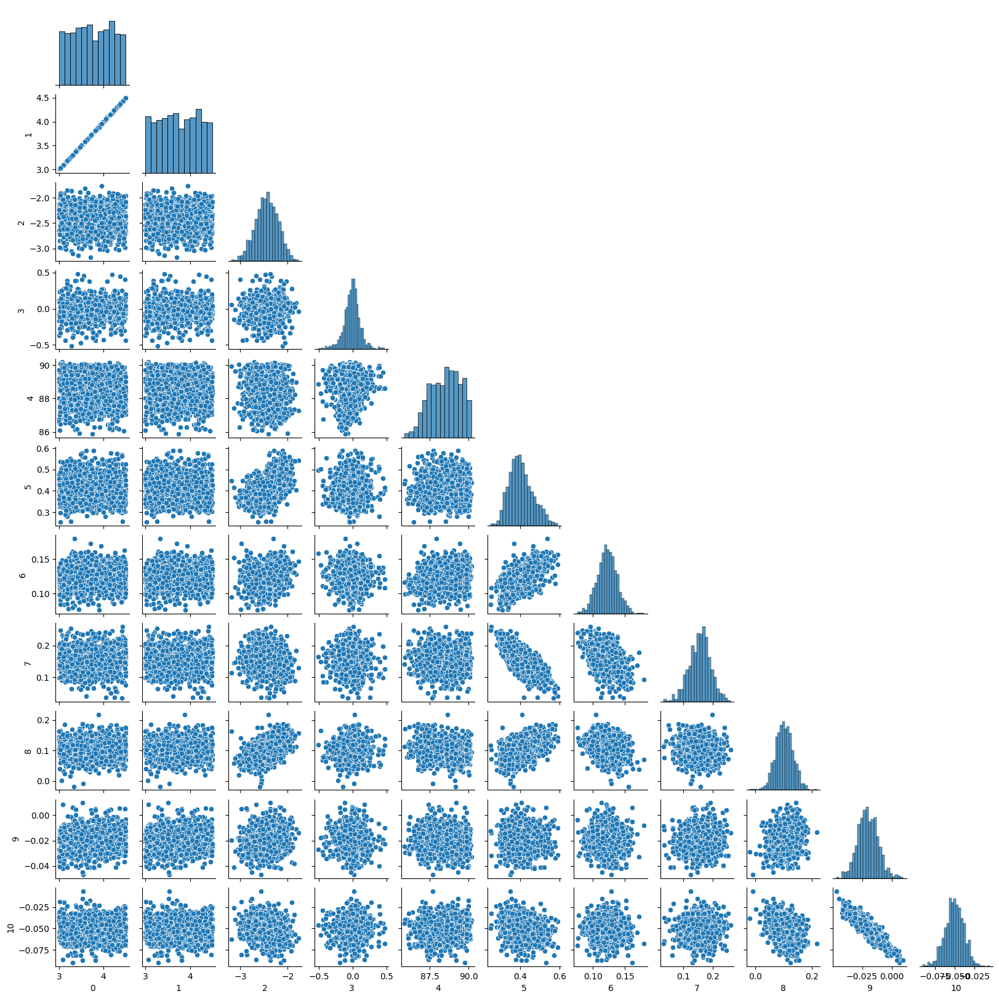

[0.43253566 0.43233092 0.23507583 0.12710188 0.95610799 0.05941167
 0.01537769 0.03610807 0.03085845 0.0086221  0.01181666]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

locallocal

local
SpawnPoolWorker-68 68
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-66 66
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-65 65
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-67 67
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [31:12<00:00,  1.70s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


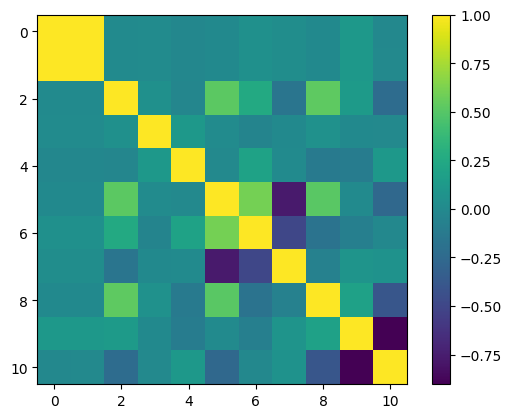

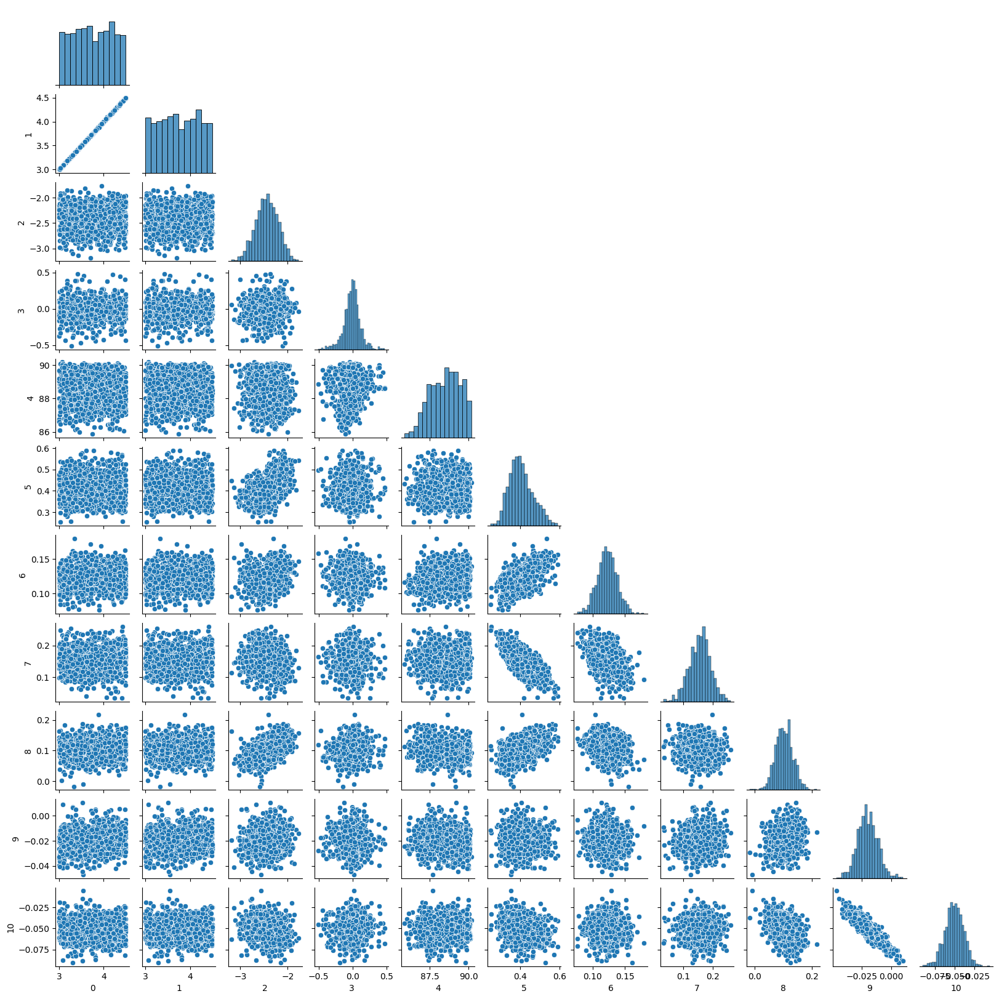

[0.43253287 0.43233287 0.23507459 0.12708716 0.95568629 0.05942785
 0.01525798 0.03612892 0.03075745 0.00859902 0.01181902]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
local
SpawnPoolWorker-70SpawnPoolWorker-71 71
 70
CUDA_VISIBLE_DEVICES=CUDA_VISIBLE_DEVICES=  00

SpawnPoolWorker-72 72
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-69 69
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [30:36<00:00,  1.67s/it]


(1085, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


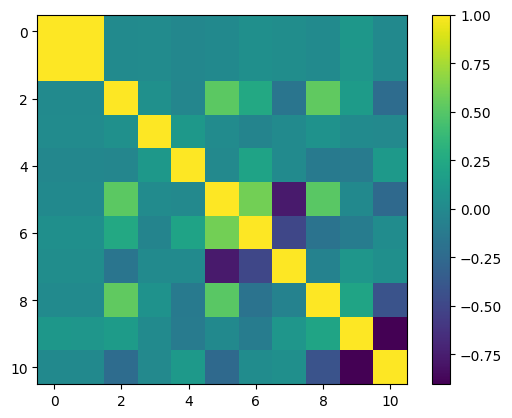

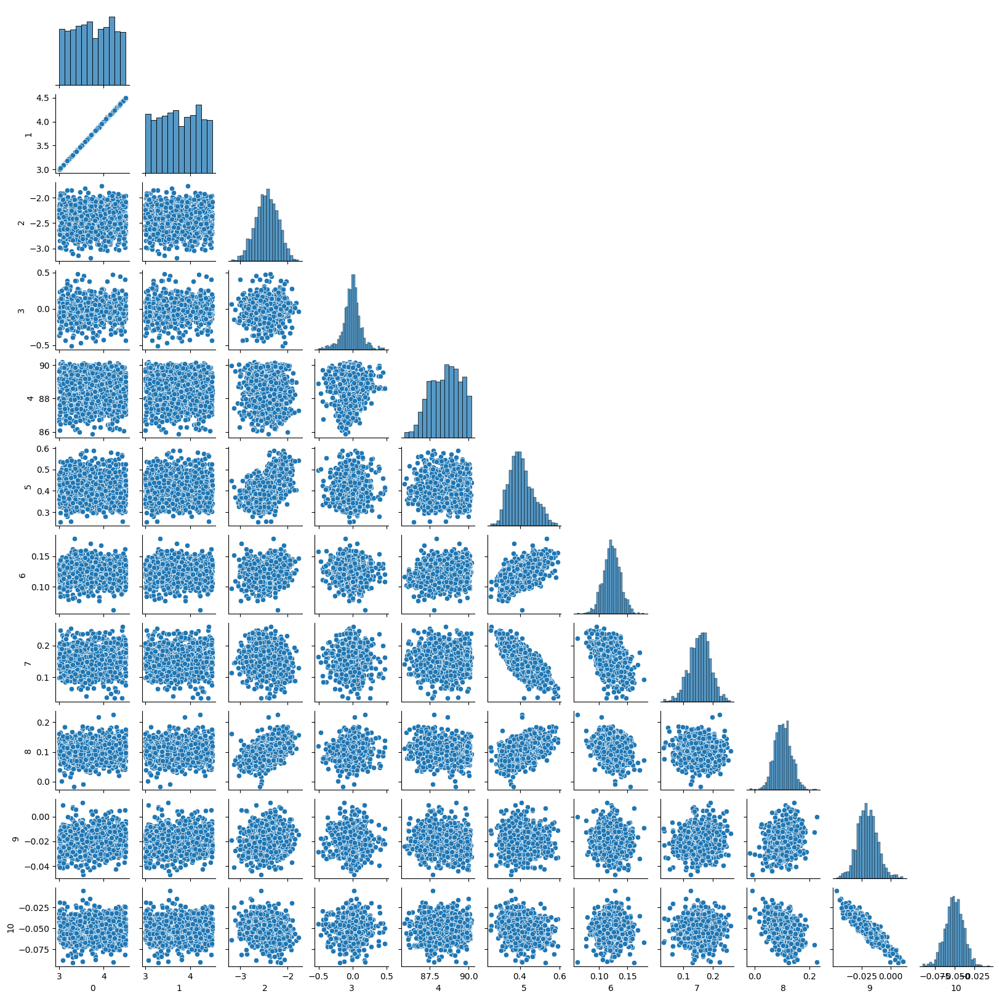

[0.43257403 0.43236735 0.23507217 0.12704141 0.95683742 0.05947029
 0.01519021 0.03618783 0.03089258 0.00858377 0.01186541]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
local
SpawnPoolWorker-74 74
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-76 76
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-73 73
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-75 75
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [29:13<00:00,  1.60s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


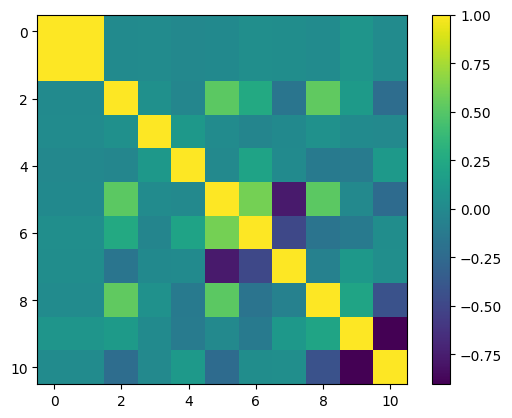

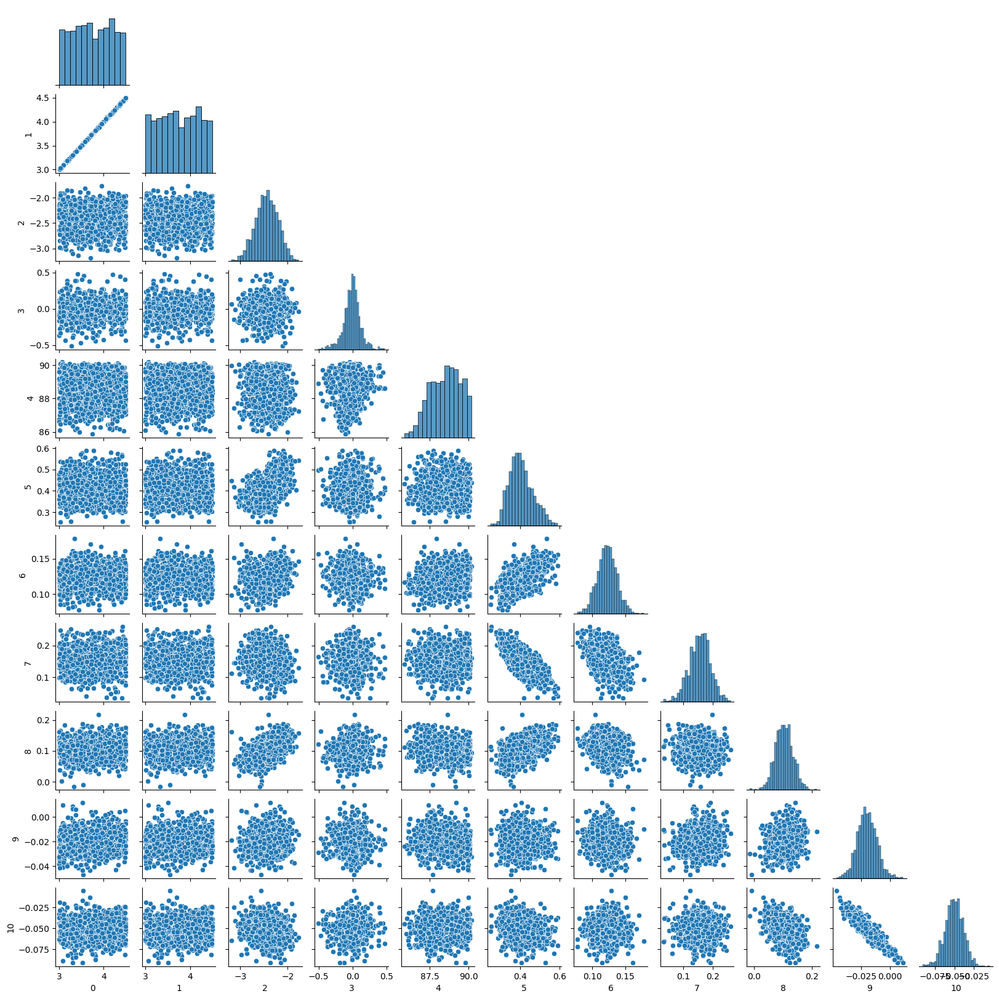

[0.43253693 0.43233018 0.23506674 0.12689833 0.95647825 0.05945584
 0.01504641 0.03615888 0.03069542 0.00857414 0.01186433]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
SpawnPoolWorker-77 77
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-80 80
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-78 78
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-79 79
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:52<00:00,  1.58s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


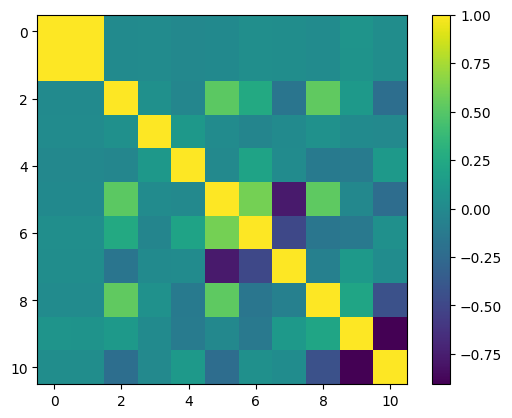

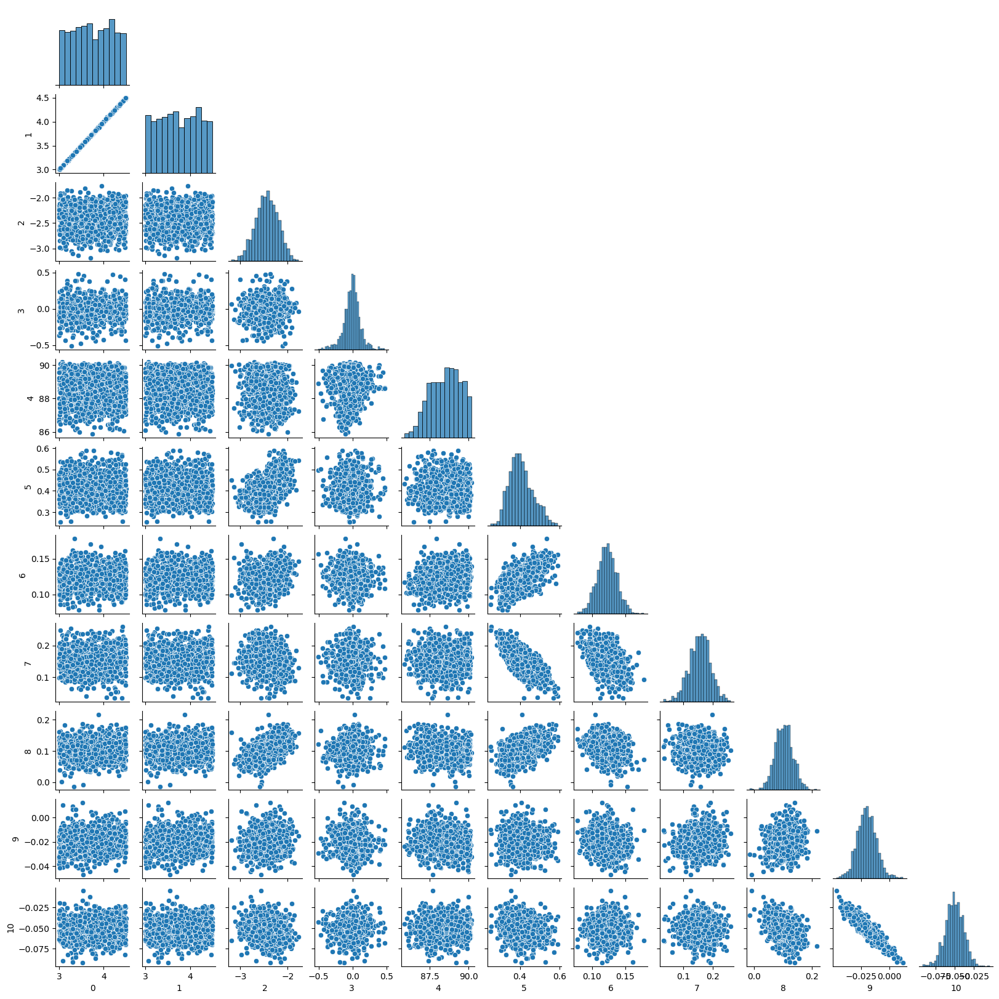

[0.4325337  0.43233119 0.23506127 0.12686627 0.95755744 0.05948906
 0.014913   0.03614457 0.03052313 0.00857199 0.01188237]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
SpawnPoolWorker-84 84
CUDA_VISIBLE_DEVICES= 0
locallocal

local
SpawnPoolWorker-81 81
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-82 82
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-83 83
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:47<00:00,  1.57s/it]


(1085, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


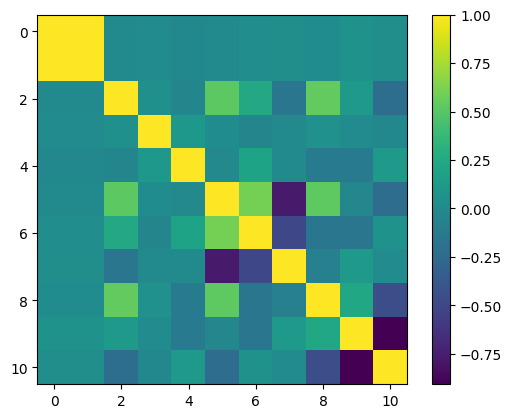

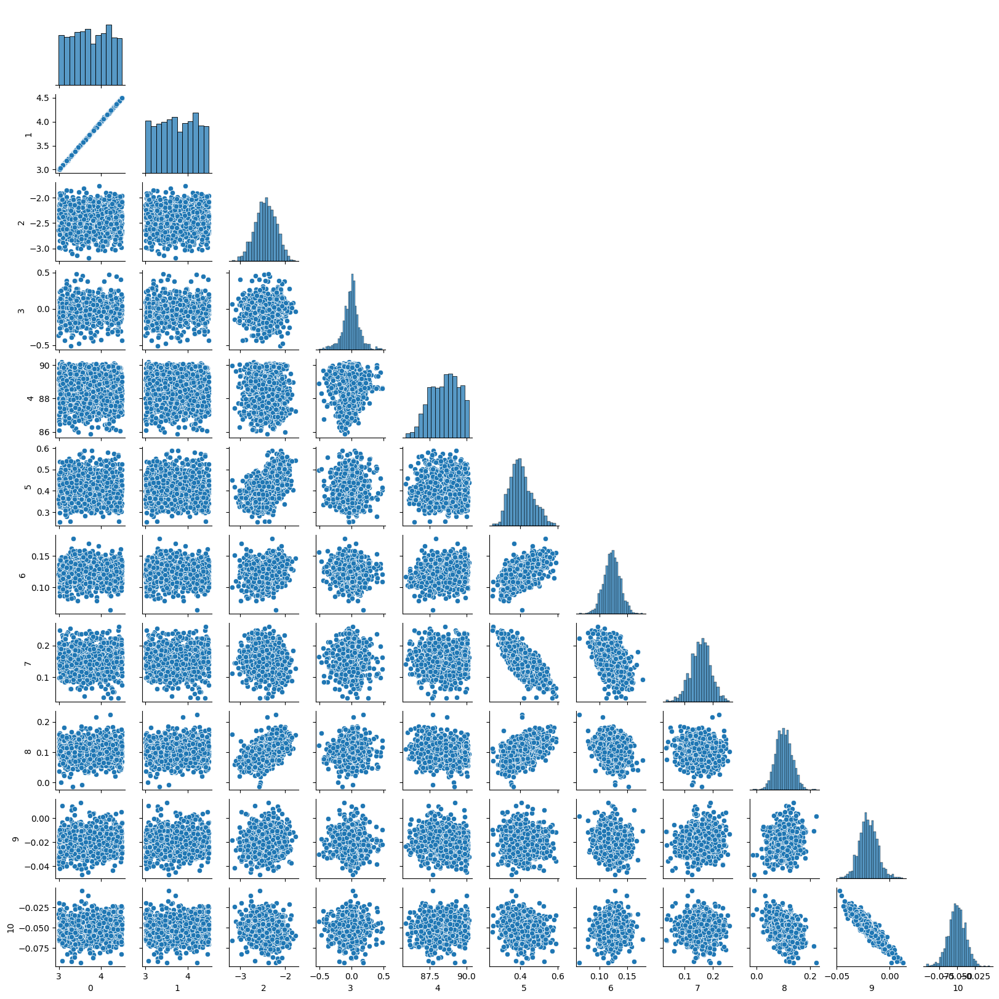

[0.43257504 0.43236711 0.23505404 0.12686356 0.95711074 0.05945512
 0.01483819 0.03618615 0.03066079 0.00857337 0.01193494]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
local
SpawnPoolWorker-88 88
SpawnPoolWorker-87 87
CUDA_VISIBLE_DEVICES= 0
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-85 85
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-86 86
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [29:00<00:00,  1.58s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


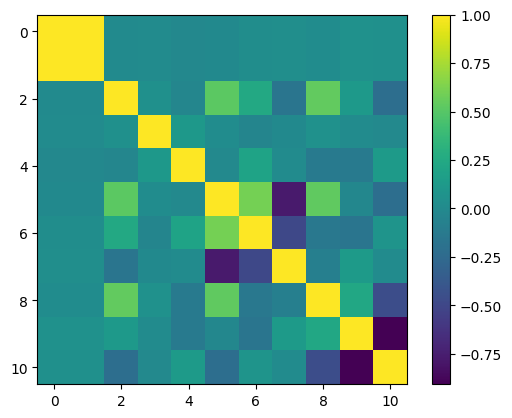

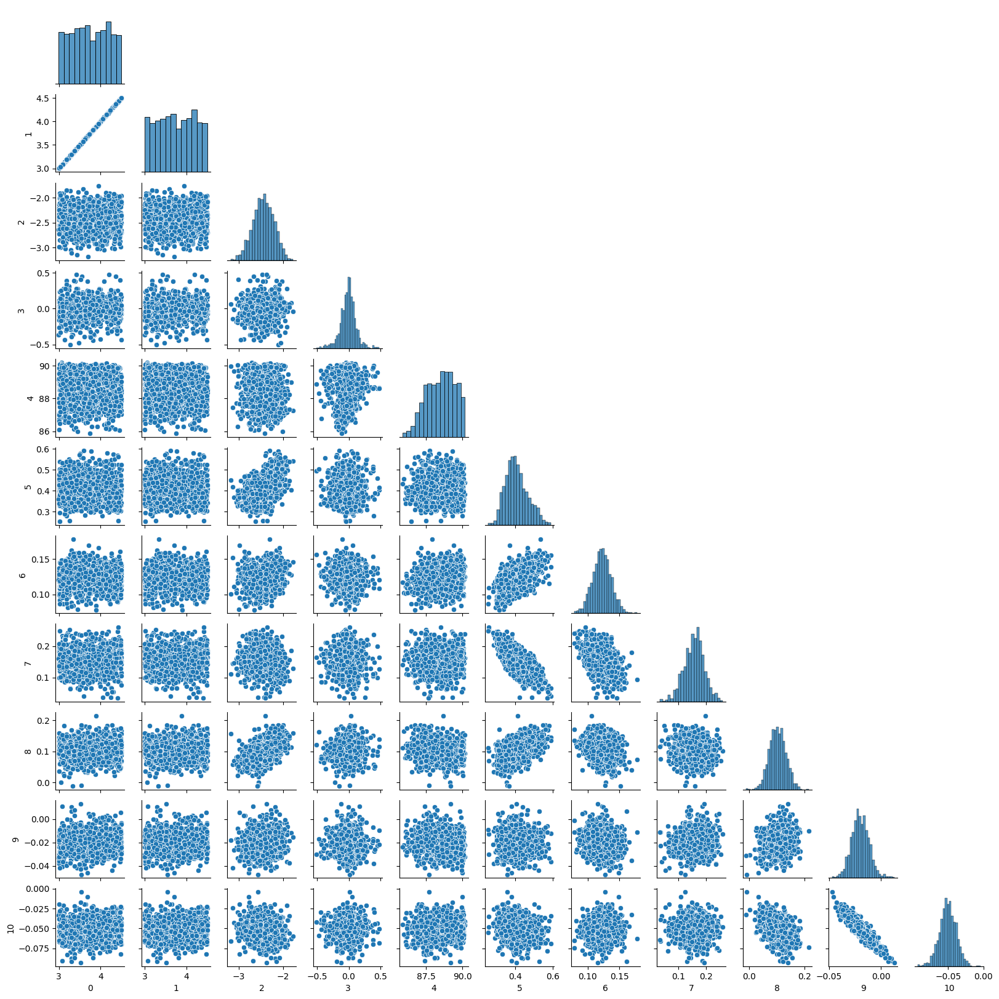

[0.43253877 0.43233079 0.235063   0.12675176 0.95819179 0.05950352
 0.0146955  0.03618953 0.03046692 0.0085577  0.01191303]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

locallocal

local
local
SpawnPoolWorker-92SpawnPoolWorker-89 89
 92
CUDA_VISIBLE_DEVICES=CUDA_VISIBLE_DEVICES=  00

SpawnPoolWorker-91 91
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-90 90
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:56<00:00,  1.58s/it]


(1085, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


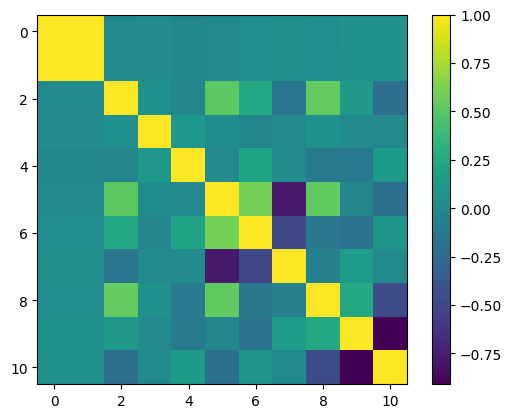

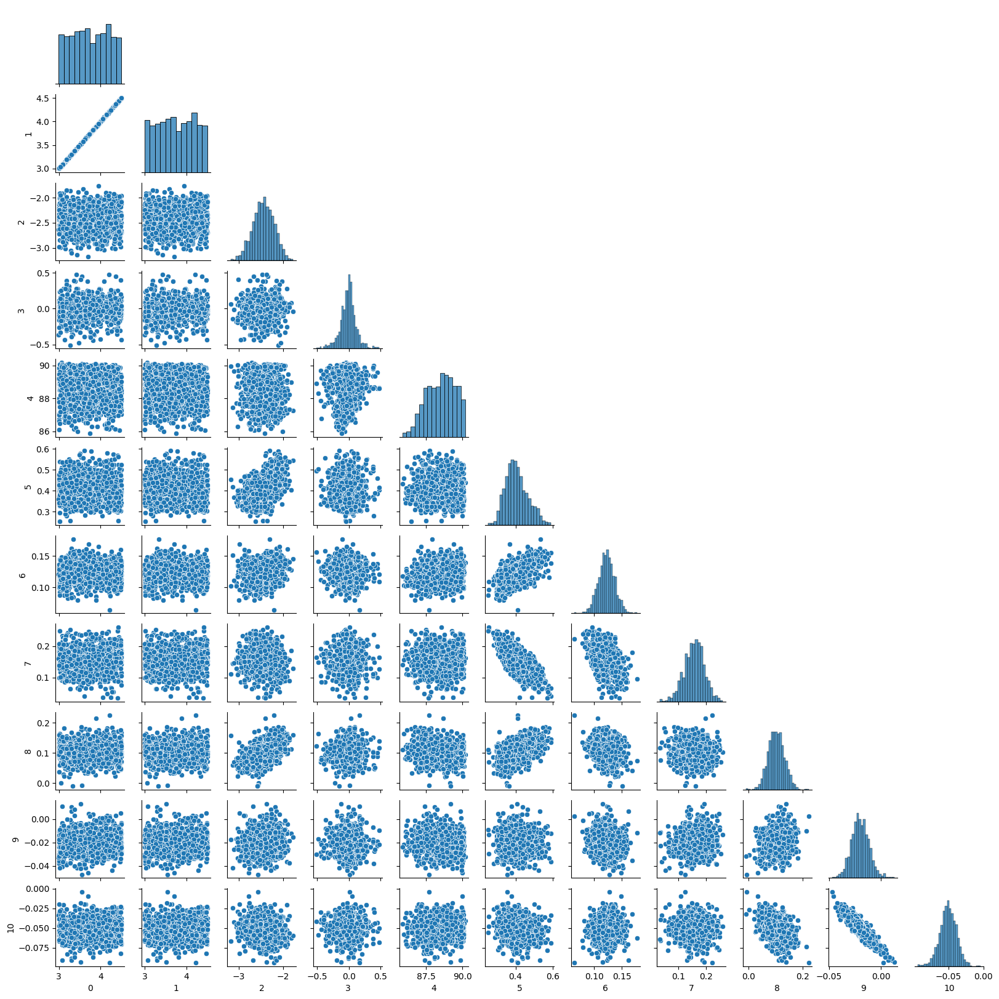

[0.43257612 0.43236677 0.2350589  0.12678248 0.95768508 0.05945114
 0.01471676 0.03619519 0.03050215 0.0085953  0.01199905]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
SpawnPoolWorker-96 96
SpawnPoolWorker-93 93
CUDA_VISIBLE_DEVICES= 0
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-94 94
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-95 95
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:52<00:00,  1.58s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


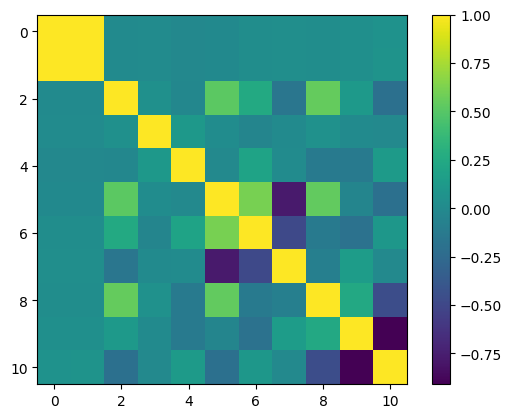

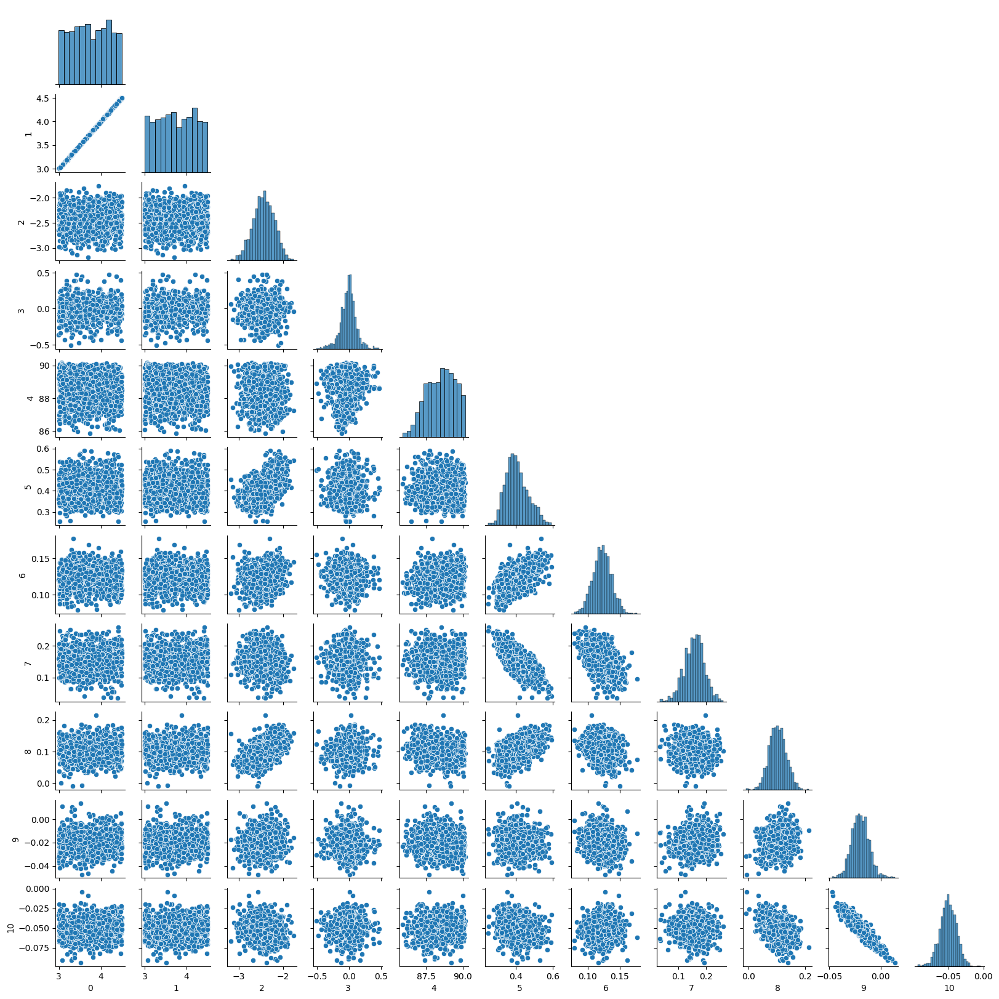

[0.43253781 0.43232986 0.23505813 0.12668026 0.95882005 0.05946668
 0.01457771 0.03614545 0.03030389 0.00860107 0.01200763]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
SpawnPoolWorker-100 100
SpawnPoolWorker-98 98
CUDA_VISIBLE_DEVICES=CUDA_VISIBLE_DEVICES=  00

local
SpawnPoolWorker-99 99
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-97 97
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:55<00:00,  1.58s/it]


(1085, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


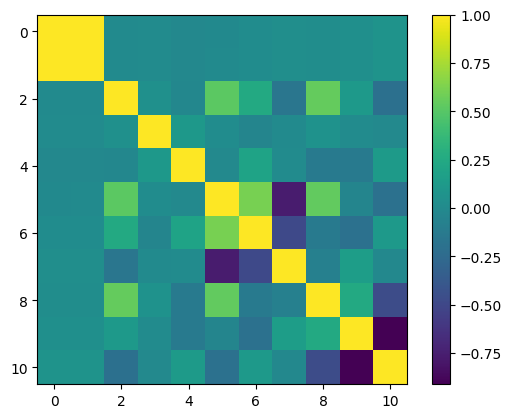

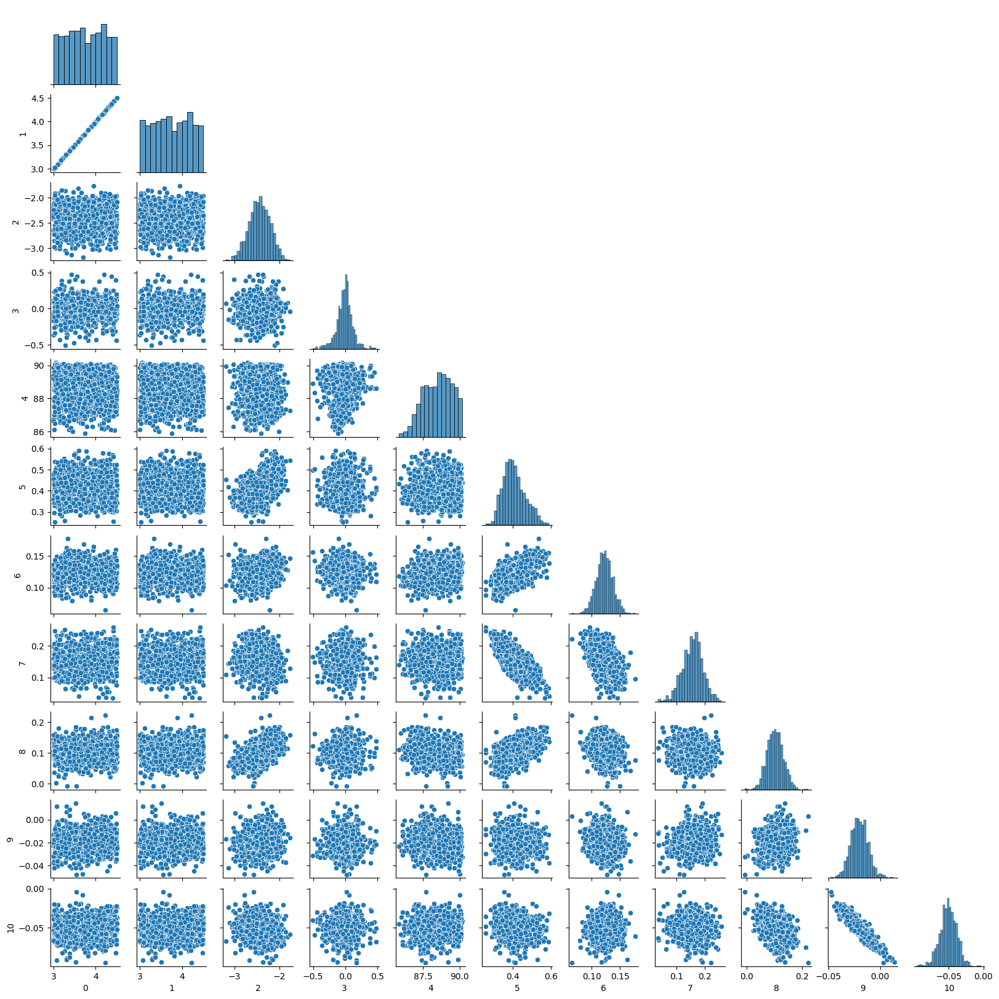

[0.43257598 0.43236706 0.23505969 0.12671284 0.95833855 0.05945631
 0.0145878  0.03617502 0.03034216 0.00863681 0.01210277]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
SpawnPoolWorker-104 104
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-101 101
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-103 103
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-102 102
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:54<00:00,  1.58s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


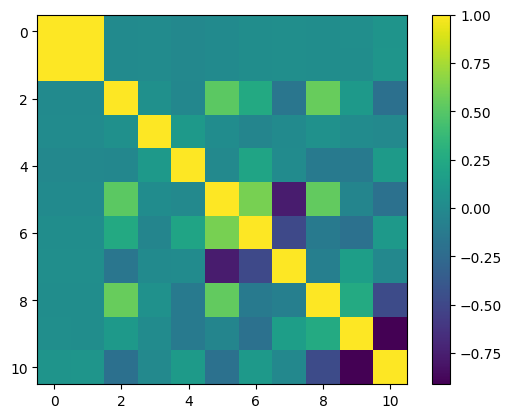

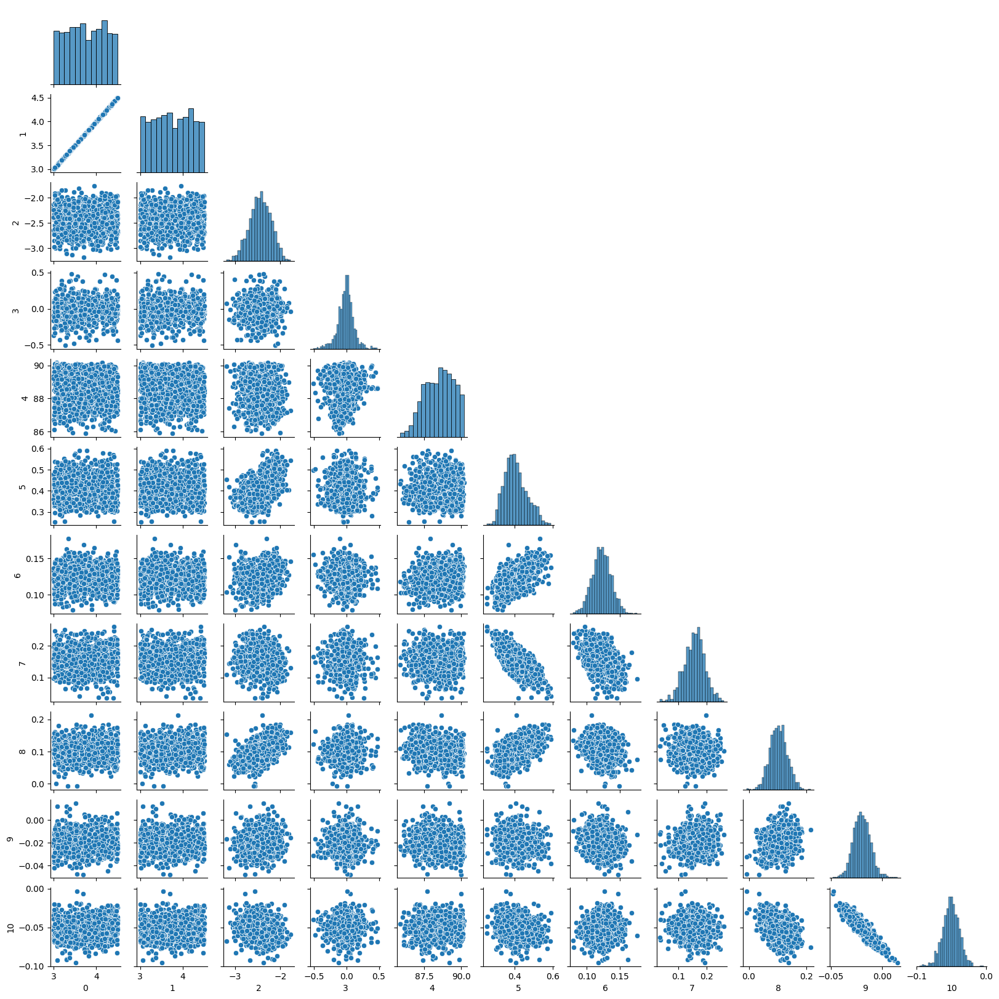

[0.43253915 0.43232952 0.23506193 0.12660554 0.95974056 0.05944964
 0.01445008 0.03612947 0.03015447 0.00862891 0.0121057 ]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
local
SpawnPoolWorker-106 106
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-108 108
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-105 105
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-107 107
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:54<00:00,  1.58s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


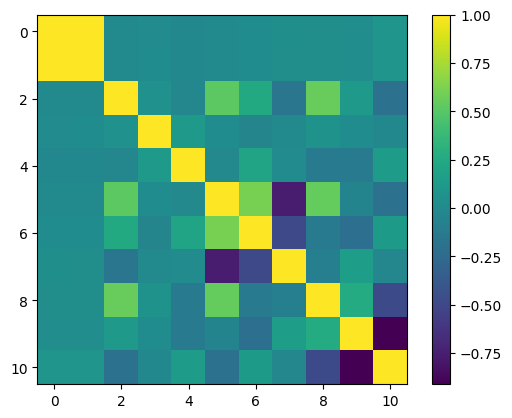

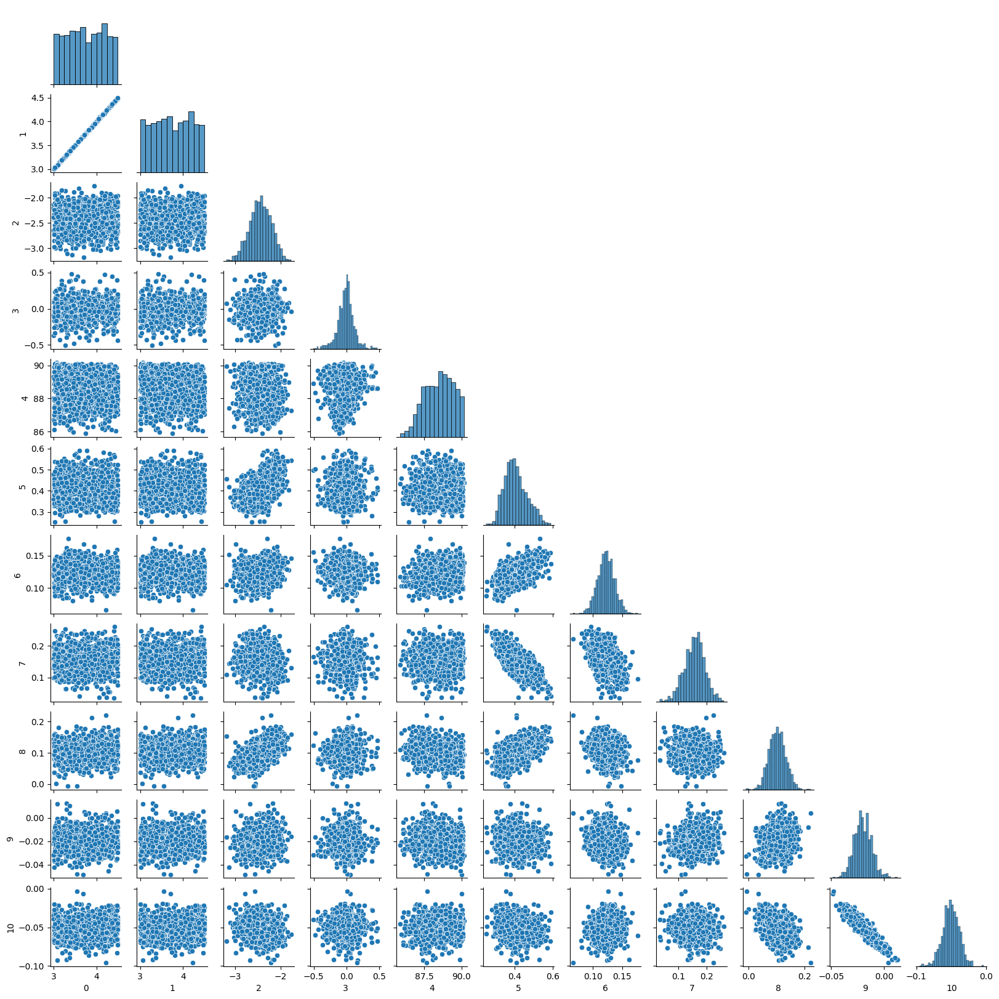

[0.43271861 0.43250356 0.23514633 0.12661553 0.95912449 0.05947672
 0.01442807 0.0361513  0.03019349 0.00862691 0.0121474 ]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
local
local
local
SpawnPoolWorker-109SpawnPoolWorker-111 111
 109
CUDA_VISIBLE_DEVICES=CUDA_VISIBLE_DEVICES=  00

SpawnPoolWorker-112 112
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-110 110
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:46<00:00,  1.57s/it]


(1084, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


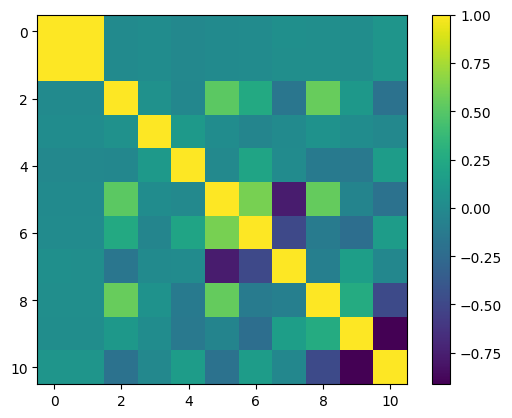

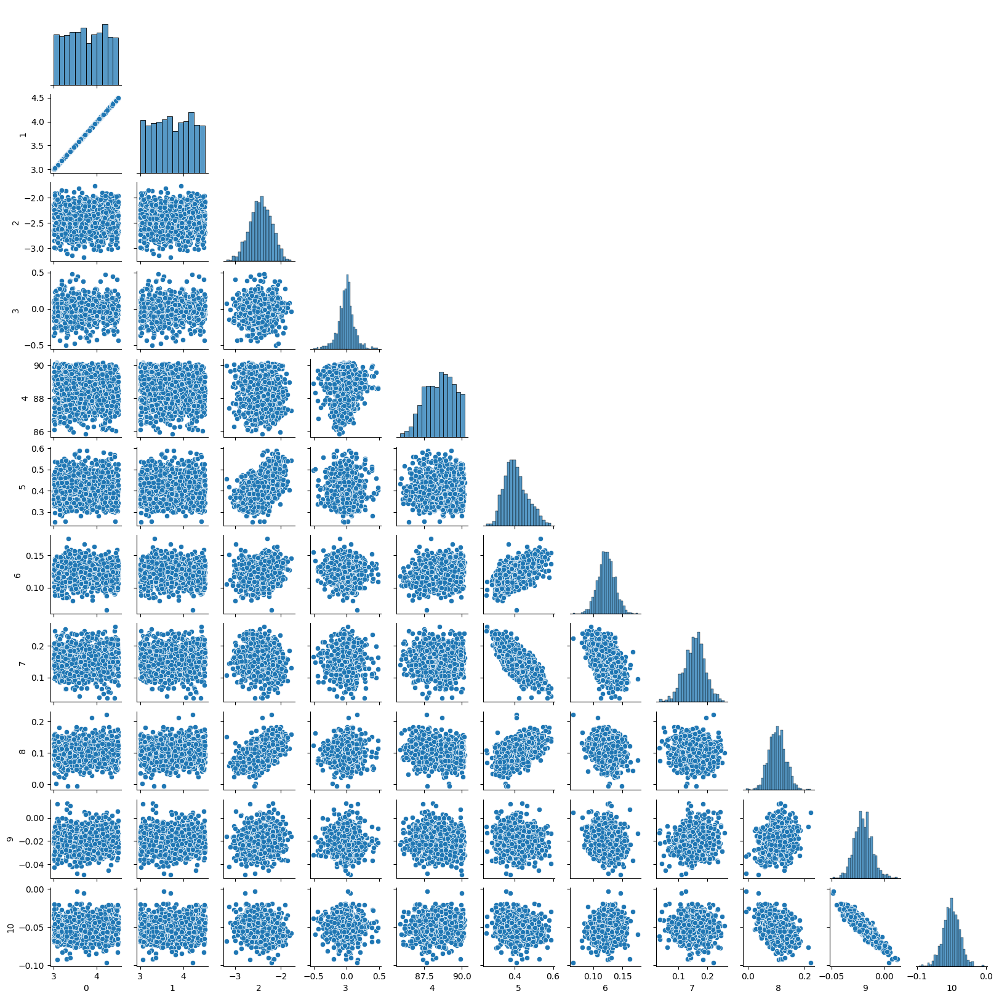

[0.43272067 0.43250411 0.23514924 0.12657788 0.96007473 0.05950958
 0.01441373 0.03618924 0.03016891 0.00862415 0.01219896]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

local
SpawnPoolWorker-113 113
CUDA_VISIBLE_DEVICES= 0
local
local
local
SpawnPoolWorker-116 116
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-114 114
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-115 115
CUDA_VISIBLE_DEVICES= 0


Processing in parallel: 100%|███████████████████████████████████████████████████████| 1099/1099 [28:38<00:00,  1.56s/it]


(1083, 11)


/home/jcottaar/miniconda3/envs/xlab/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


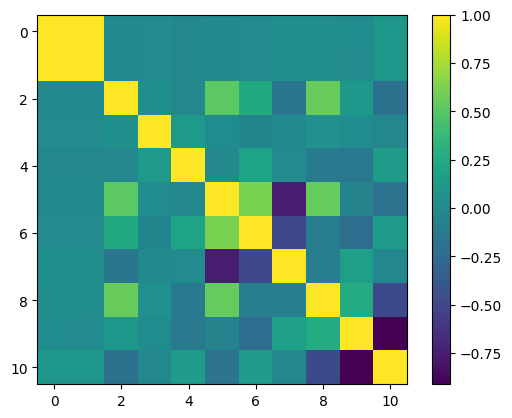

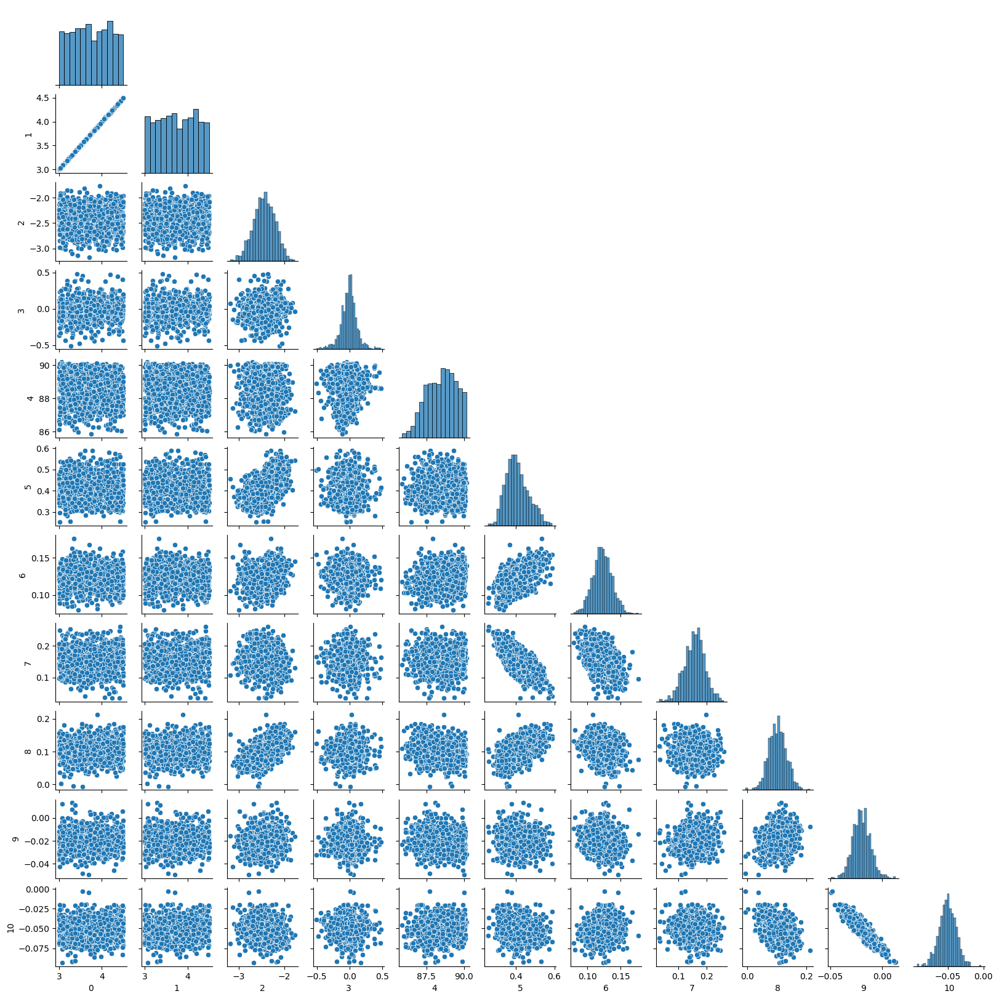

[0.43268159 0.43246651 0.23515066 0.12648473 0.95949191 0.05949986
 0.01425008 0.03614885 0.02996731 0.00859273 0.01213806]


Processing in parallel:   0%|                                                                  | 0/1099 [00:00<?, ?it/s]

locallocal

local
SpawnPoolWorker-119SpawnPoolWorker-117 117
 119
CUDA_VISIBLE_DEVICES= 0
CUDA_VISIBLE_DEVICES= 0
SpawnPoolWorker-118 118
CUDA_VISIBLE_DEVICES= 0
local
SpawnPoolWorker-120 120
CUDA_VISIBLE_DEVICES= 0


Processing in parallel:  66%|█████████████████████████████████████▏                  | 729/1099 [19:06<09:44,  1.58s/it]

In [ ]:
kgs.sanity_checks_active = False
for ii in range(50):
    if ii==5:
        data = copy.deepcopy(train_data2)
    data = model.infer(data)
    transit_parameters = []
    for d in data:
        d.diagnostics['starting_par'] = d.diagnostics['par_mean']
        modelr.results['model_samples'].m['signal'].set_parameters(d.diagnostics['par_samples'])
        transit_parameters.append(modelr.results['model_samples'].m['signal'].m['main'].m['transit'].get_parameters()[:,0])
    transit_parameters = np.array(transit_parameters)
    
    transit_parameters = remove_outlier(transit_parameters,4)
    print(transit_parameters.shape)

    plt.figure()
    plt.imshow(np.corrcoef(transit_parameters.T))
    plt.colorbar()
    sns.pairplot(pd.DataFrame(transit_parameters), diag_kind="hist", corner=True, height=1.5)
    plt.pause(0.0001)

    cov_est = np.cov(transit_parameters.T)
    print(np.sqrt(np.diag(cov_est)))
    mu_est = np.mean(transit_parameters,0)
    def modify_func(model, cc):
        model.m['signal'].m['main'].m['transit'].cov_override = cc[0]
        model.m['signal'].m['main'].m['transit'].mu_override = cc[1]
        # cur_params = model.m['signal'].m['main'].m['transit'].get_parameters()
        # cur_params[-model.m['signal'].m['main'].m['transit'].number_of_extra_parameters:,0] = cc[1]
        # model.m['signal'].m['main'].m['transit'].set_parameters(cur_params)
        return model
    model.model_options.modify_func = modify_func
    model.model_options.modify_func_input = [cov_est, mu_est]
    
    kgs.dill_save(kgs.temp_dir + f'transit_model_tuning{ii}.pickle', (cov_est, mu_est))

In [ ]:
# import subprocess

# # Hibernate Windows
# # subprocess.run(
# #     ["/mnt/c/Windows/System32/shutdown.exe", "/a"],  # add "/f" to force-close apps
# #     check=True
# # )
# subprocess.run(
#     ["/mnt/c/Windows/System32/shutdown.exe", "/h"],  # add "/f" to force-close apps
#     check=True
# )